In [1]:
from __future__ import print_function, division
%run ../basics.ipynb
from sklearn.metrics import silhouette_score

Populating the interactive namespace from numpy and matplotlib


/opt/anaconda2/lib/python2.7/site-packages/IPython/core/magics/pylab.py:161: UserWarning: pylab import has clobbered these variables: ['show_config']
`%matplotlib` prevents importing * from pylab and numpy
  "\n`%matplotlib` prevents importing * from pylab and numpy"


Loading BokehJS ...

Using Theano backend.


In [2]:
df = pd.read_csv('../data/auto_tagging_confirmed.csv')
#df['tag'] = df['tag'].apply(lambda x: ' '.join(x.split(' | ')))
df['tag'] = df['all_tag'].apply(lambda x: ' '.join(set([j for i in map(lambda y: y.split('>')[1:], 
                                                                       x.split(' | ')) for j in i])))
all_tags = set([j for i in df['tag'].values for j in i.split()])
d = list()
for t in all_tags:
    d.append((t, df['tag'].apply(lambda x: t in x).sum()))
display(pd.DataFrame(columns=['tag', 'n_r'], data=d).sort_values(by='n_r'))
display(df.head(2))
#print(df.iloc[0]['all_tag'])

print(df.columns)
print(df.count()/len(df)*100)
print(len(df))

,tag,n_r
0,fMRI,1
73,security,1
62,association_rule_learning,1
43,neuroimaging,1
74,Galaxy,1
31,mobile_devices,1
29,HTML,1
27,XML,1
23,information_retrieval,1
13,NoSQL,1


,id,description,title,subtitle,syllabus,tag,all_tag,fold_num
0,http://videolectures.net/acml2013_herbrich_rea...,The last ten years have seen a tremendous grow...,"Distributed, Real-Time Bayesian Learning in On...",NaN,NaN,computer_science video probability_statistics ...,resource_depth>in_depth | data_science_process...,2
1,http://videolectures.net/acml2013_lin_cost_sen...,Classification is an important problem in mach...,Cost-sensitive Classification: Algorithms and ...,NaN,NaN,computer_science video probability_statistics ...,resource_depth>in_depth | data_science_process...,2


Index([u'id', u'description', u'title', u'subtitle', u'syllabus', u'tag',
       u'all_tag', u'fold_num'],
      dtype='object')
id             100.000000
description     83.535109
title          100.000000
subtitle        28.087167
syllabus        11.138015
tag            100.000000
all_tag        100.000000
fold_num       100.000000
dtype: float64
413


In [3]:
#df = df[df[['title', 'subtitle', 'description', 'syllabus']].apply(lambda x: len((' '.join(map(str,x))).split()), axis=1) >= 100]

In [4]:
class CLF(object):
    def __init__(self, n_topics=20, tfidf_max_df=None, tfidf_min_df=None, tag_vec_max_df=None, tag_vec_min_df=None, 
                 ngram_range=None, nmf=True, **kwargs):
        self.n_topics = n_topics
        self.vectorizer = TfidfVectorizer(stop_words='english',
                                          max_df=0.6 if tfidf_max_df is None else tfidf_max_df,
                                          min_df=5 if tfidf_min_df is None else tfidf_min_df,
                                          ngram_range=(1 ,3) if ngram_range is None else ngram_range)
        
        self.tag_vectorizer = CountVectorizer(max_df=1. if tag_vec_max_df is None else tag_vec_max_df,
                                              min_df=0. if tag_vec_min_df is None else tag_vec_min_df)
        
        self.nmf = NMF(n_components=n_topics, random_state=2016) if nmf else None
        self.rf = None
        self.topic_dict = None
        self.kwargs = kwargs

    def fit(self, X, y, viz=True):
        orig_X = X.copy()
        X = self.prepare_X(X)
        X = self.vectorize_X(X, fit=True, viz=viz)
        if viz:
            try:
                tsne_plot(X, orig_X[[orig_X.columns[0]]], fit=True)
            except:
                print(traceback.format_exc())
        y = self.vectorize_y(y, fit=True)
        
    def transform(self, X):
        X = self.prepare_X(X)
        X = self.vectorize_X(X, fit=False)
        return X
    
    def score(self, X, y):
        X = self.transform(X)
        return silhouette_score(X, np.array(X.argmax(axis=1)).flatten())
            
    @staticmethod
    def prepare_X(X):
        if isinstance(X, pd.DataFrame):
            concat_x = pd.Series(index=X.index, data='')
            for i in X.columns:
                concat_x += ' ' + X[i].apply(text_cleanup)
            X = concat_x
        else:
            assert isinstance(X, pd.Series)
        return X
        
    def vectorize_X(self, X, fit=False, viz=False):
        if fit:
            tfidf = self.vectorizer.fit_transform(X.values)
        else:
            tfidf = self.vectorizer.transform(X.values)
        #tfidf, words = filter_word_rep(tfidf, self.vectorizer.get_feature_names())
        words = self.vectorizer.get_feature_names()
        #print('tfidf shape', tfidf.shape)
        # tfidf = (tfidf > 0.).astype('float')
        if not os.path.isdir('topic_wordclouds/'):
            os.makedirs('topic_wordclouds/')
        if self.nmf is not None:
            if fit:
                nmf = self.nmf.fit_transform(tfidf)
                feature_names = words
                n_top_words = 50
                self.topic_dict = dict()
                for topic_idx, topic in enumerate(self.nmf.components_):
                    topic_top_words = [feature_names[i]
                                    for i in topic.argsort()[:-n_top_words - 1:-1]]
                    topic_top_words_vals = sorted(topic.ravel(), reverse=True)[:n_top_words]
                    text_freq = zip(topic_top_words, topic_top_words_vals)
                    if viz:
                        print("v v v v \tTopic #%d\t" % topic_idx, end='v v v v v')
                        wordcloud(text_freq)
                        plt.savefig('topic_wordclouds/' + str(topic_idx) + '.png')
                    topic_top_words = ", ".join(topic_top_words)
                    #print(topic_top_words)
                    self.topic_dict[topic_idx] = text_freq
                if viz:
                    viz_nmf_output(nmf)
            else:
                nmf = self.nmf.transform(tfidf)
            #print('nmf shape:', nmf.shape)
            return nmf
        else:
            return tfidf.todense()
    
    def plot_word_and_tag_clouds(self, X, y, fit=False, th=0., viz=False):
        X = self.prepare_X(X)
        X = self.vectorize_X(X, fit=fit, viz=viz)
        y = self.vectorize_y(y, fit=fit)
        topic_tags = defaultdict(lambda: np.zeros(y.shape[1]))
        topic_n_docs = defaultdict(int)
        for x_s, y_s in tqdm(zip(X, y)):
            x_s = np.array(x_s).flatten()
            y_s = np.array(y_s).flatten()
            for i, x_i in enumerate(x_s):
                if x_i >= th:
                    topic_tags[i] += (x_i * y_s)
                    topic_n_docs[i] += 1
        topic_freq = {key: zip(self.get_tag_names(), val) for key, val in topic_tags.items()}
        for key, text_freq in self.topic_dict.items():
            print('-' * 80)
            print('# resources:', topic_n_docs[key])
            wordcloud(text_freq)
            wordcloud(topic_freq[key])
    
    def vectorize_y(self, y, fit=False):
        if fit:
            y = y.fillna(' ')
            y = self.tag_vectorizer.fit_transform(y.values)
            #if self.tag_vectorizer.stop_words_:
            #    print('ignored tags:')
            #    print(' ,'.join(self.tag_vectorizer.stop_words_))
            #print('considered tags: (tag, resources tagged in %)')
            #print(' ,'.join(map(str, sorted(zip(self.tag_vectorizer.get_feature_names(), 
            #                  np.array(y.sum(axis=0)).flatten()/y.shape[0]*100, 
            #                  np.array(y.sum(axis=0)).flatten()), key=itemgetter(1), reverse=True))))
        else:
            y = self.tag_vectorizer.transform(y.values)
        y = (y > 0).astype('float').todense()
        #print('y shape', y.shape)
        return y
    
    def get_tag_names(self):
        return self.tag_vectorizer.get_feature_names()

# resources: 413
tagged resources: 413
v v v v 	Topic #0	v v v v v

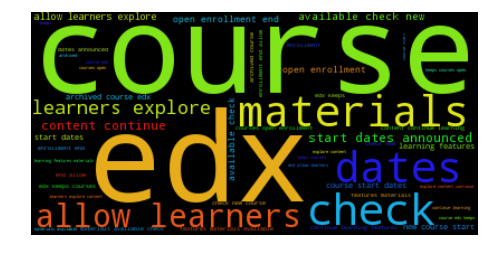

v v v v 	Topic #1	v v v v v

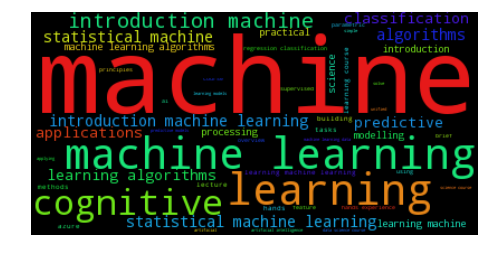

v v v v 	Topic #2	v v v v v

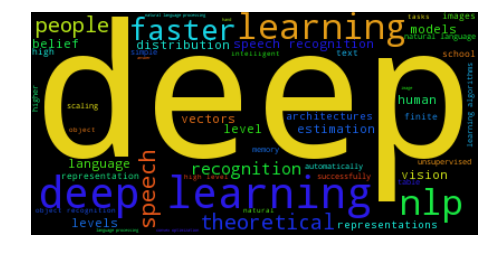

v v v v 	Topic #3	v v v v v

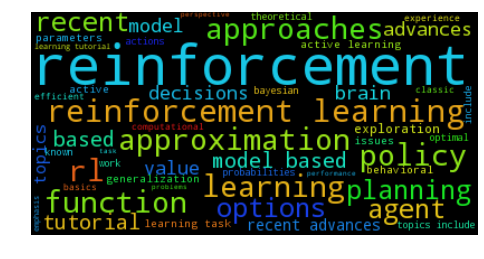

v v v v 	Topic #4	v v v v v

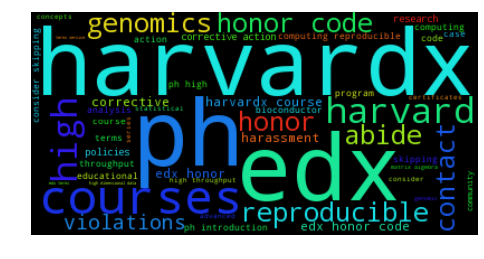

v v v v 	Topic #5	v v v v v

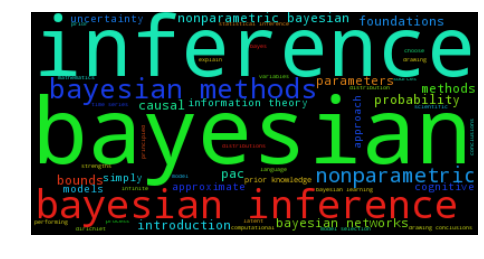

v v v v 	Topic #6	v v v v v

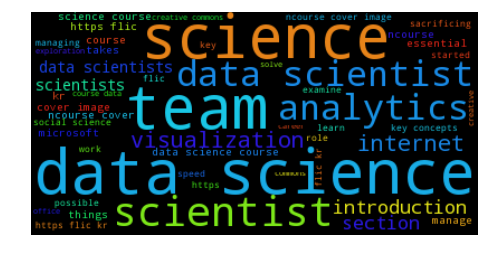

v v v v 	Topic #7	v v v v v

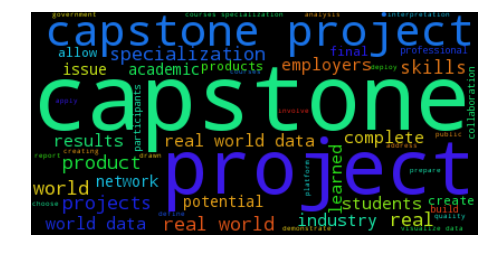

v v v v 	Topic #8	v v v v v

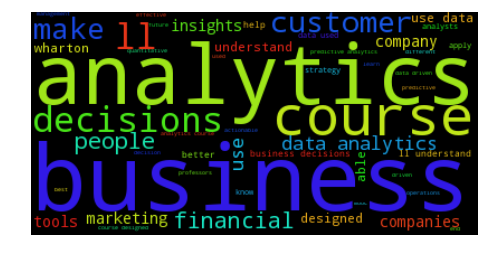

v v v v 	Topic #9	v v v v v

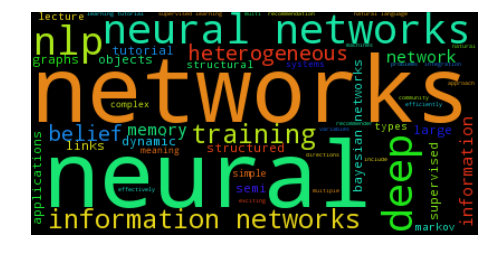

v v v v 	Topic #10	v v v v v

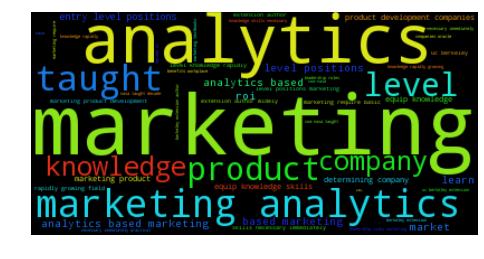

v v v v 	Topic #11	v v v v v

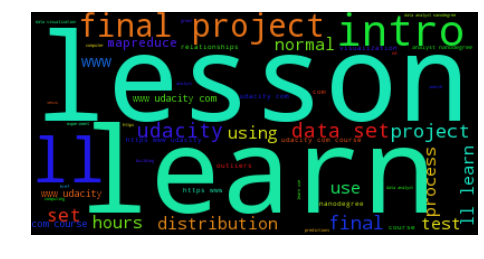

v v v v 	Topic #12	v v v v v

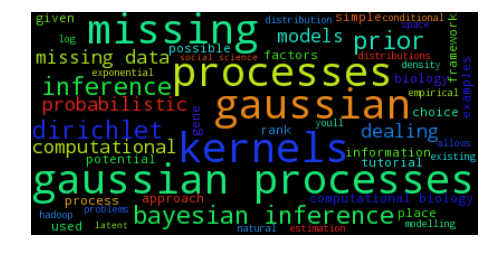

v v v v 	Topic #13	v v v v v

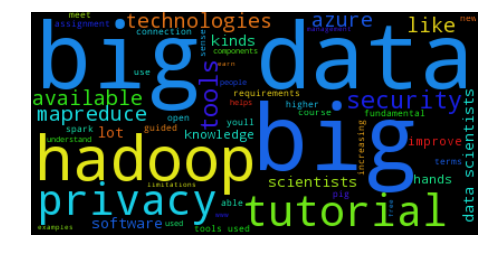

v v v v 	Topic #14	v v v v v

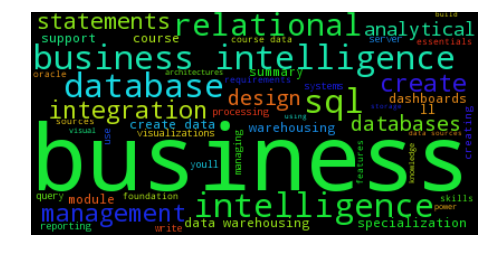

v v v v 	Topic #15	v v v v v

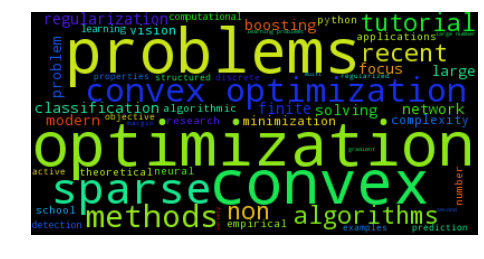

v v v v 	Topic #16	v v v v v

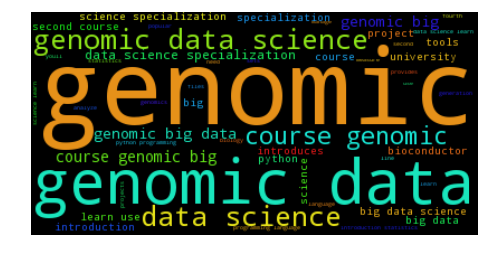

v v v v 	Topic #17	v v v v v

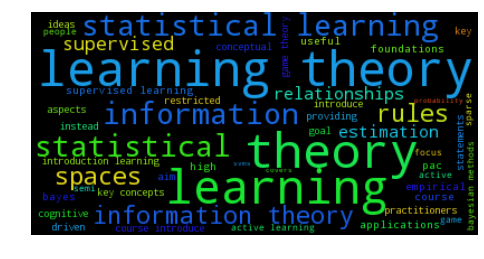

v v v v 	Topic #18	v v v v v

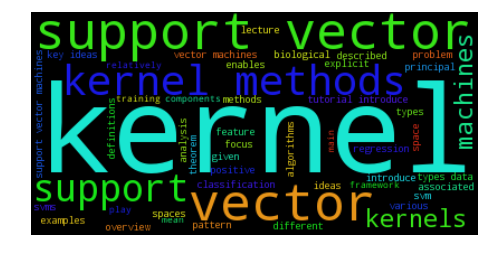

v v v v 	Topic #19	v v v v v

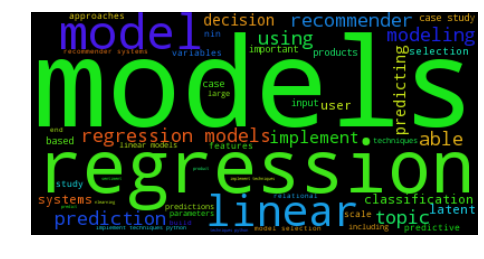

v v v v 	Topic #20	v v v v v

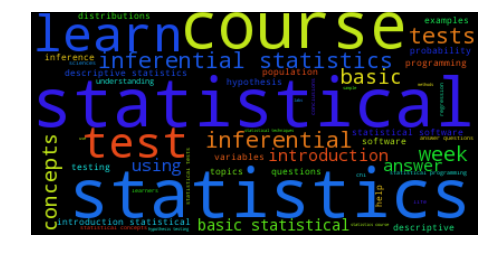

v v v v 	Topic #21	v v v v v

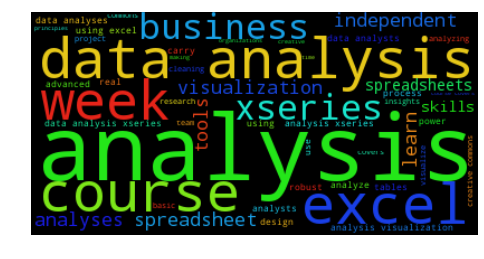

v v v v 	Topic #22	v v v v v

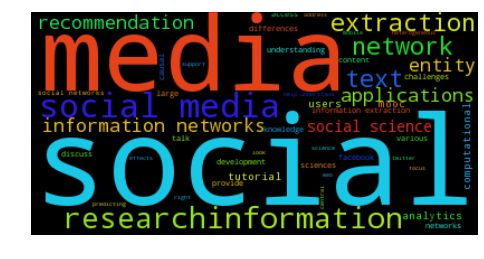

v v v v 	Topic #23	v v v v v

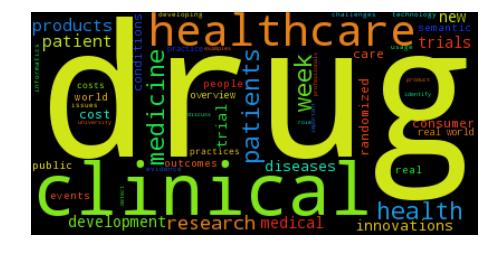

v v v v 	Topic #24	v v v v v

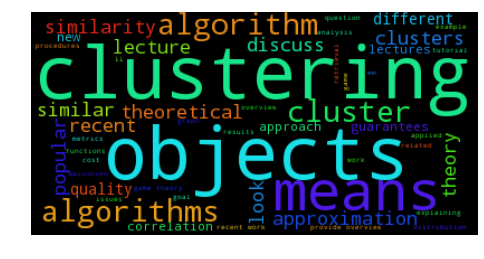

v v v v 	Topic #25	v v v v v

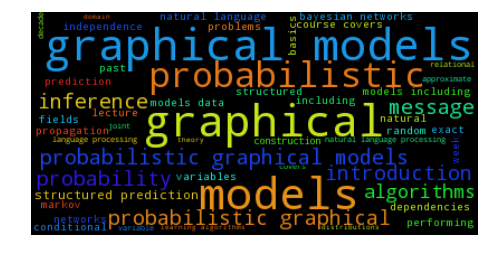

v v v v 	Topic #26	v v v v v

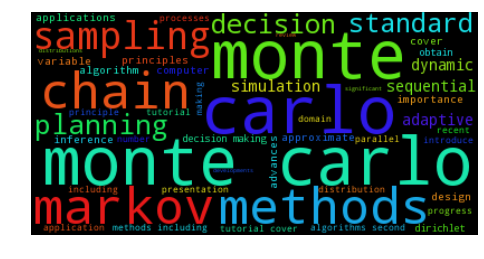

v v v v 	Topic #27	v v v v v

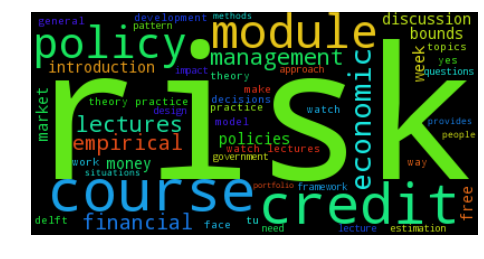

v v v v 	Topic #28	v v v v v

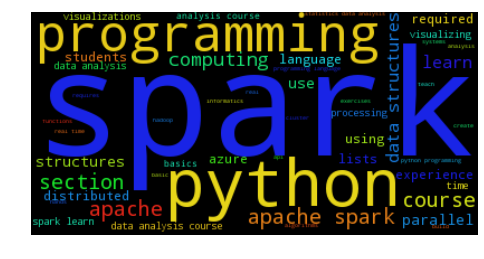

v v v v 	Topic #29	v v v v v

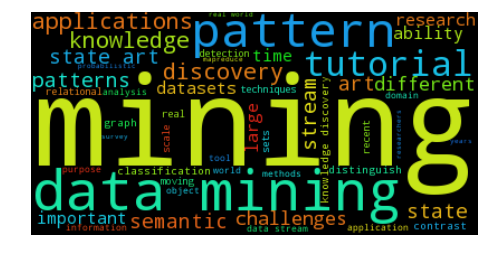

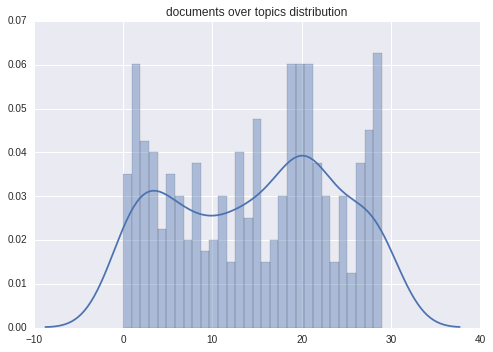

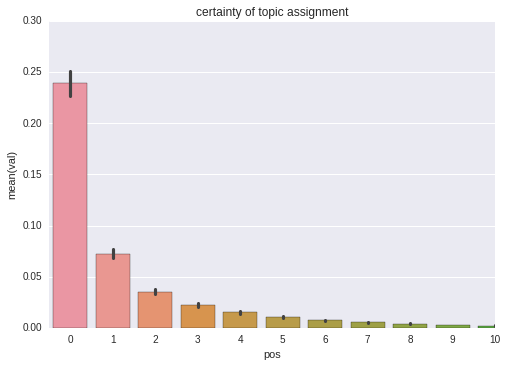

413


0.269708667391


100%|██████████| 413/413 [00:00<00:00, 15349.86it/s]


--------------------------------------------------------------------------------
# resources: 34


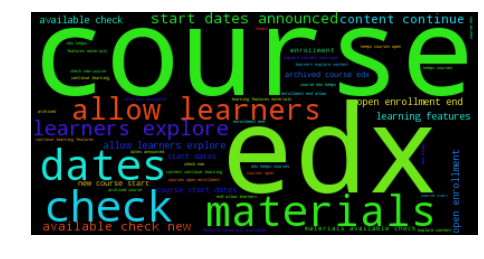

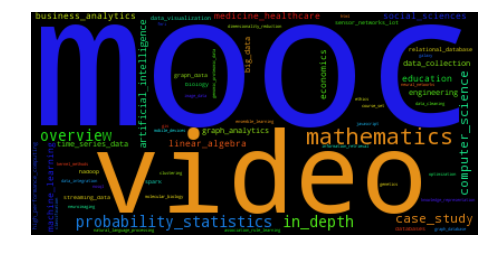

--------------------------------------------------------------------------------
# resources: 112


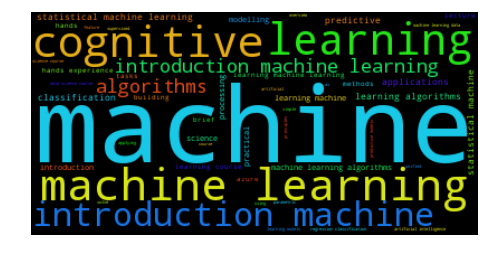

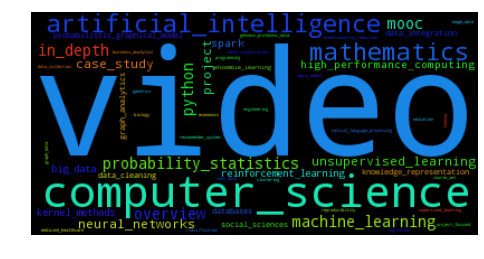

--------------------------------------------------------------------------------
# resources: 49


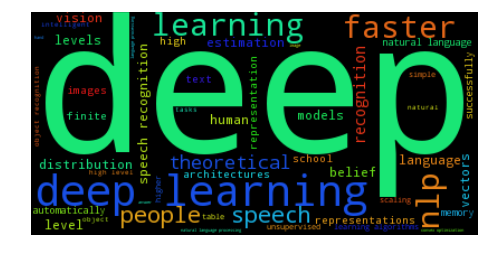

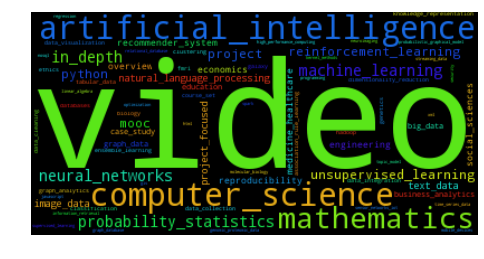

--------------------------------------------------------------------------------
# resources: 57


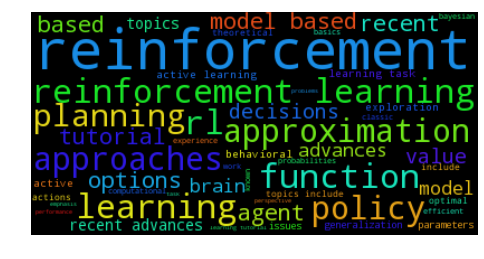

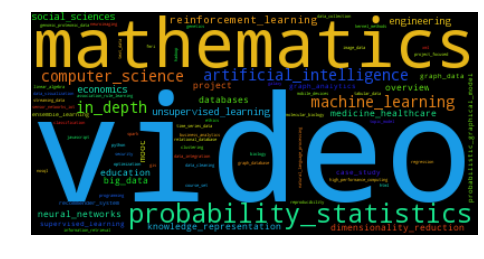

--------------------------------------------------------------------------------
# resources: 35


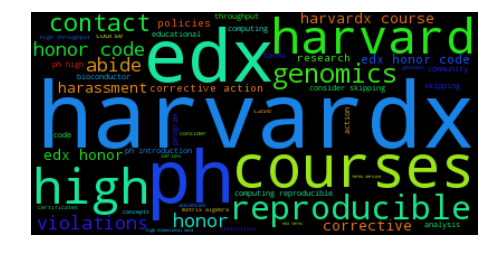

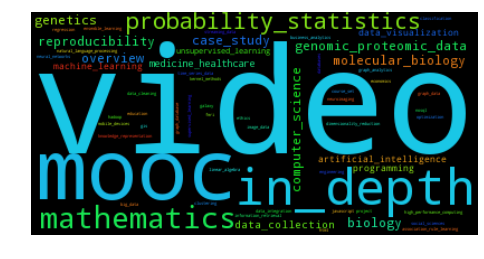

--------------------------------------------------------------------------------
# resources: 55


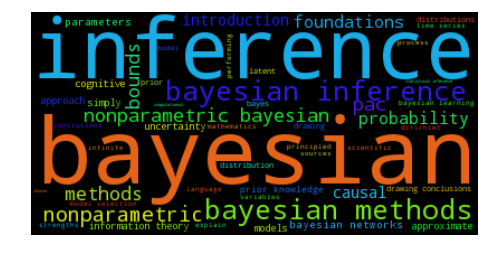

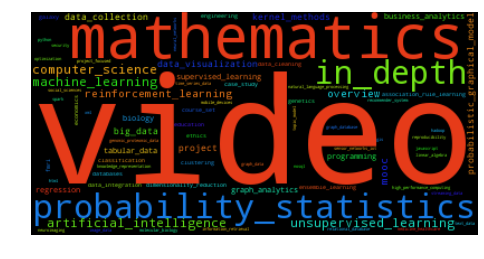

--------------------------------------------------------------------------------
# resources: 60


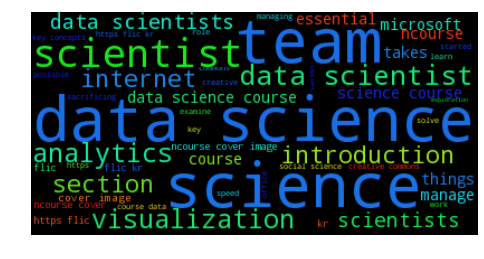

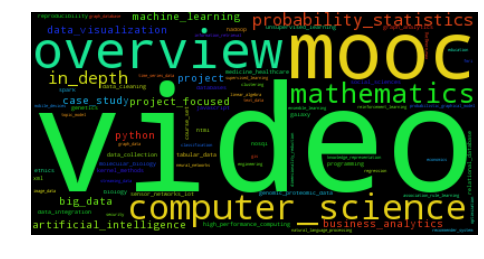

--------------------------------------------------------------------------------
# resources: 49


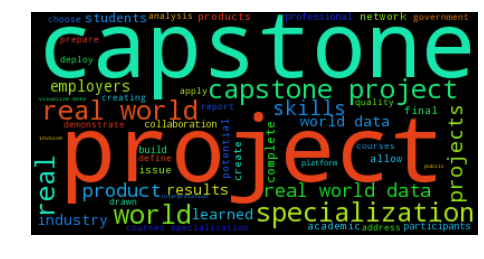

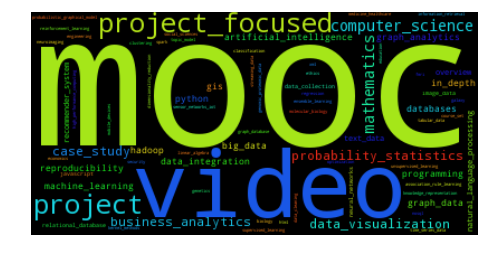

--------------------------------------------------------------------------------
# resources: 84


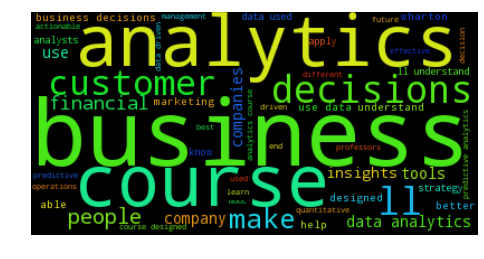

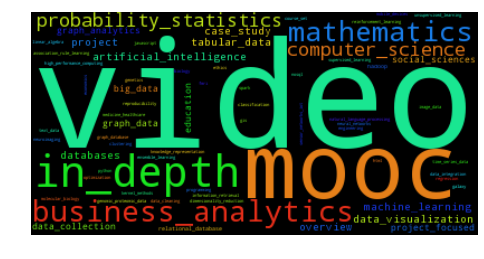

--------------------------------------------------------------------------------
# resources: 52


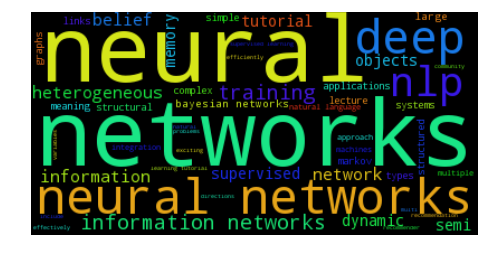

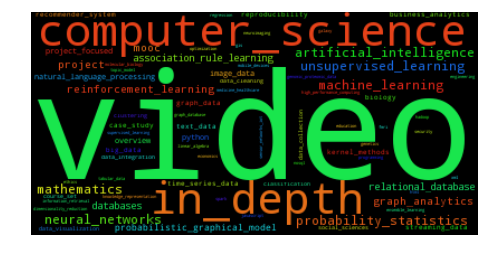

--------------------------------------------------------------------------------
# resources: 21


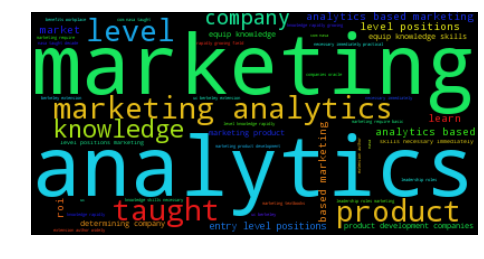

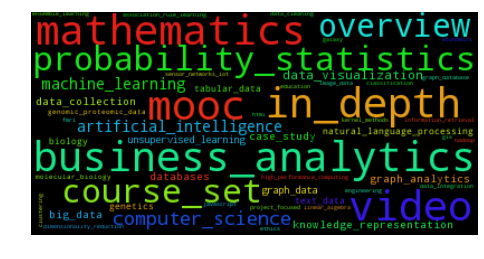

--------------------------------------------------------------------------------
# resources: 46


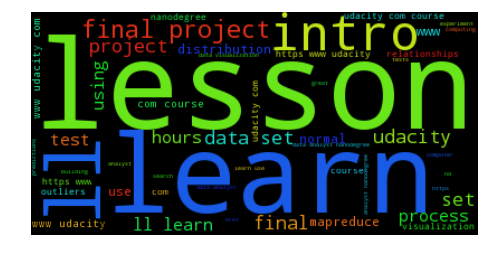

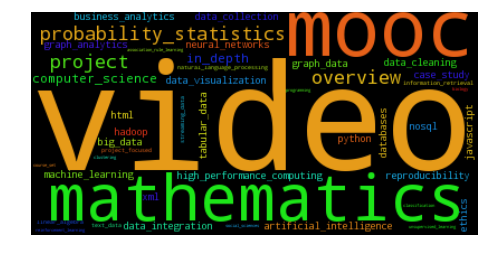

--------------------------------------------------------------------------------
# resources: 31


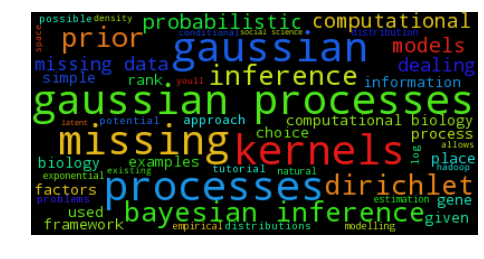

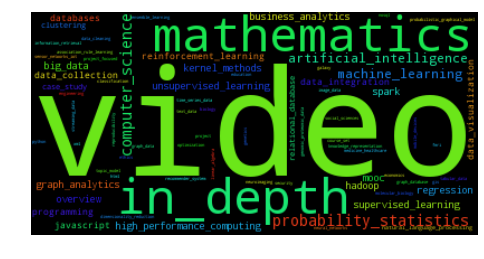

--------------------------------------------------------------------------------
# resources: 65


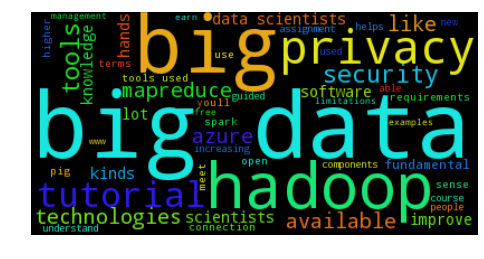

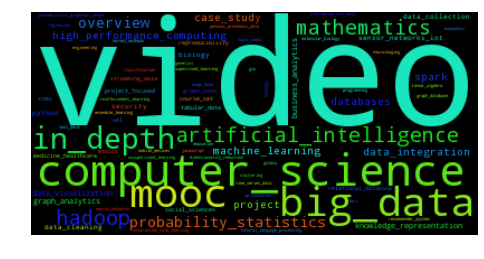

--------------------------------------------------------------------------------
# resources: 63


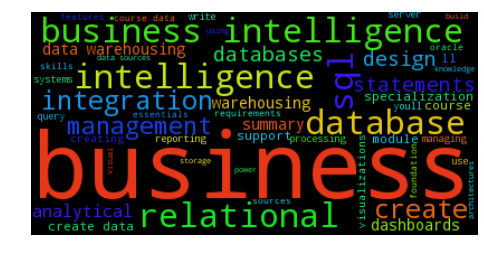

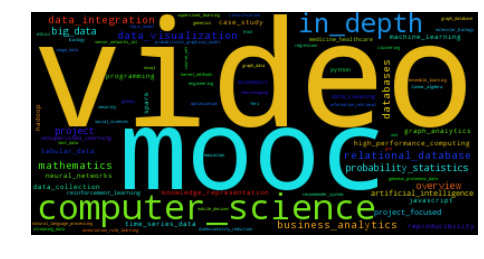

--------------------------------------------------------------------------------
# resources: 95


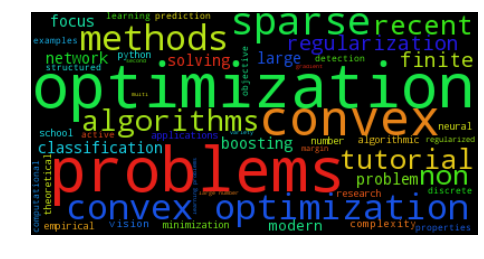

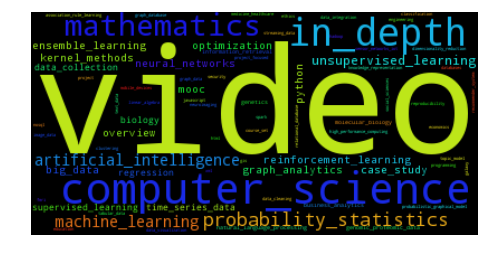

--------------------------------------------------------------------------------
# resources: 15


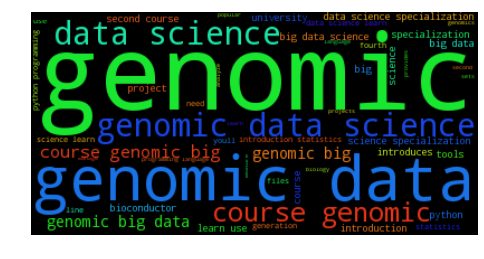

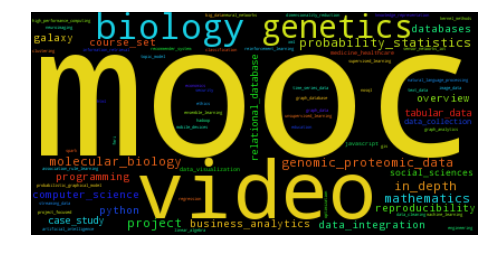

--------------------------------------------------------------------------------
# resources: 82


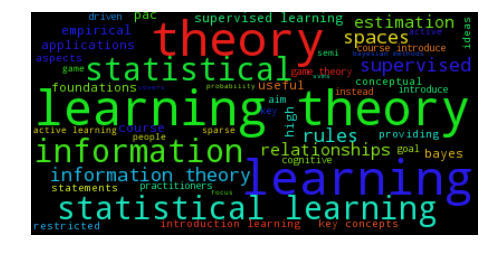

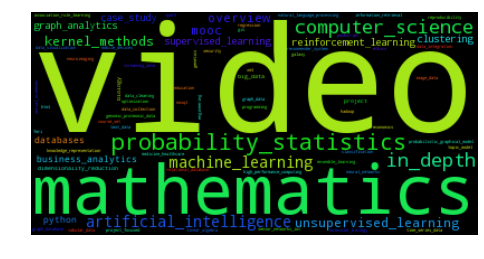

--------------------------------------------------------------------------------
# resources: 75


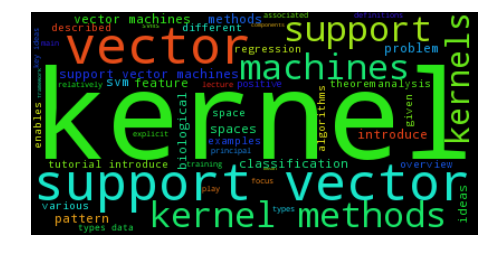

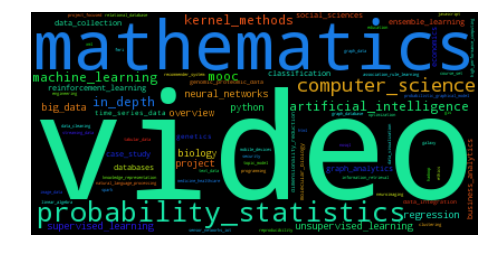

--------------------------------------------------------------------------------
# resources: 128


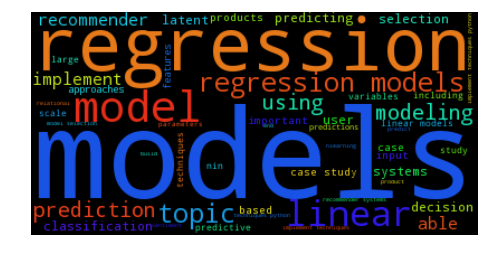

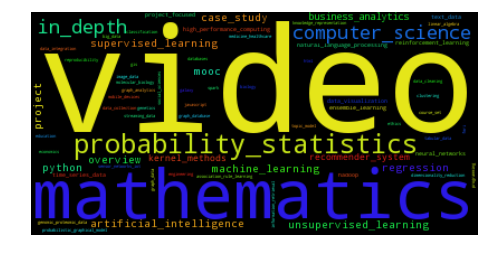

--------------------------------------------------------------------------------
# resources: 117


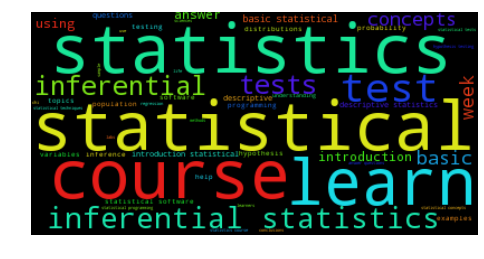

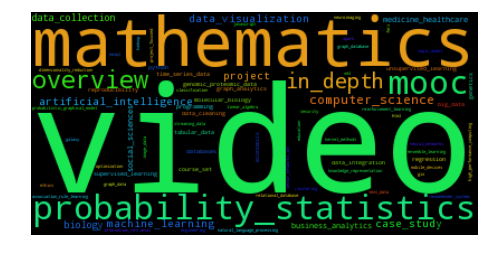

--------------------------------------------------------------------------------
# resources: 119


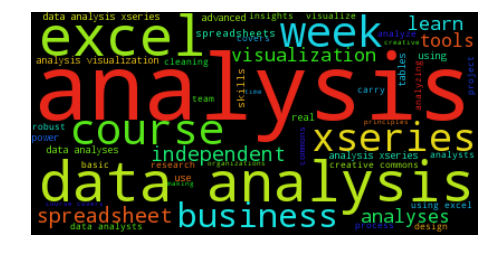

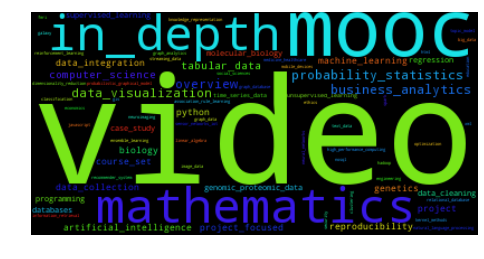

--------------------------------------------------------------------------------
# resources: 97


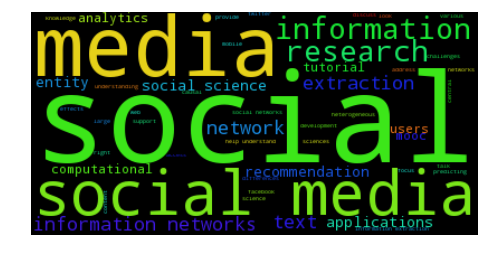

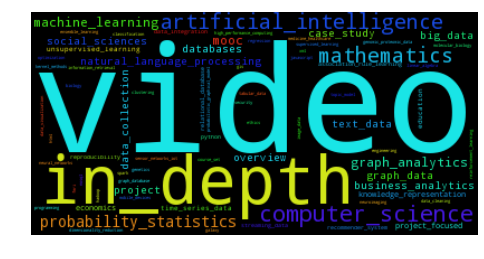

--------------------------------------------------------------------------------
# resources: 82


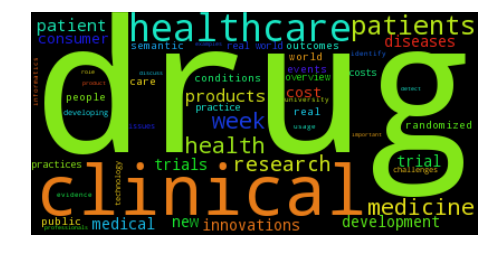

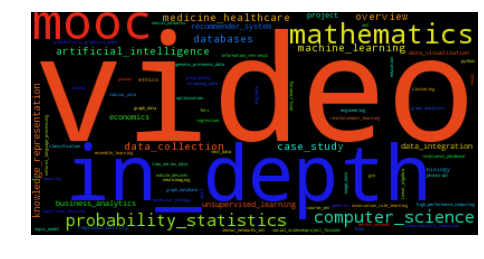

--------------------------------------------------------------------------------
# resources: 86


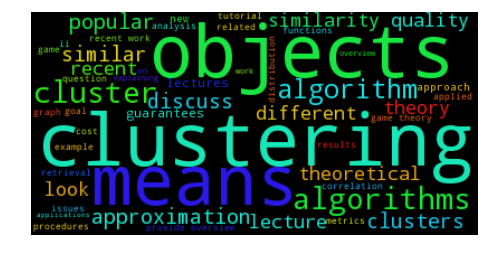

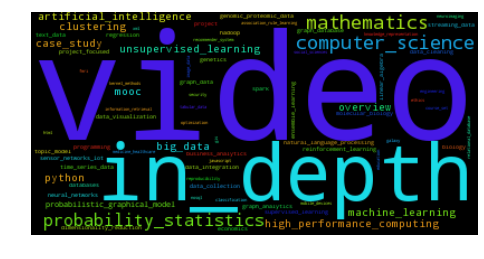

--------------------------------------------------------------------------------
# resources: 70


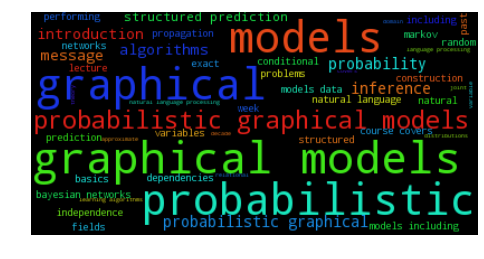

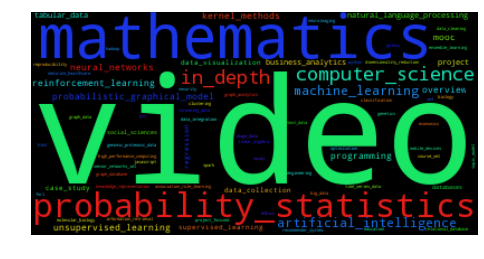

--------------------------------------------------------------------------------
# resources: 57


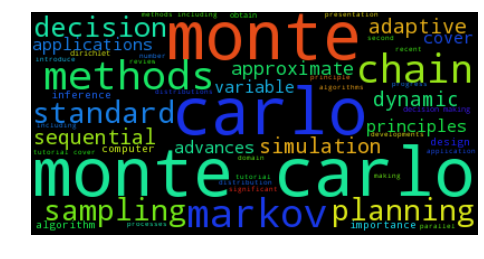

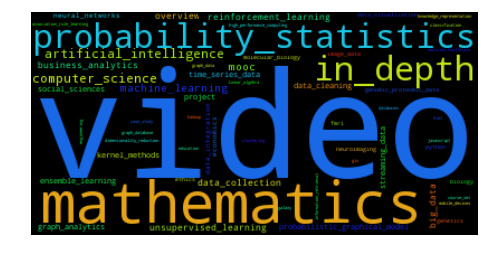

--------------------------------------------------------------------------------
# resources: 96


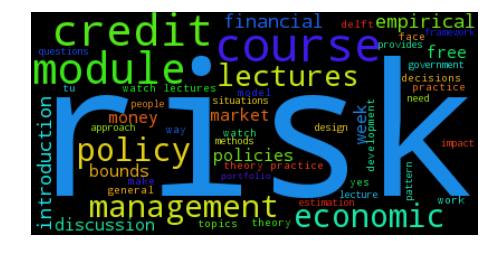

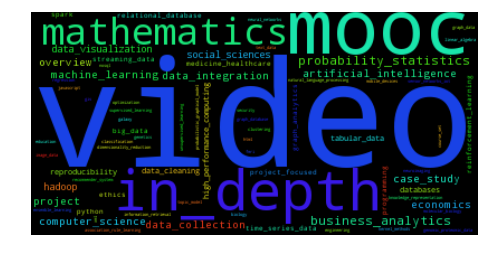

--------------------------------------------------------------------------------
# resources: 87


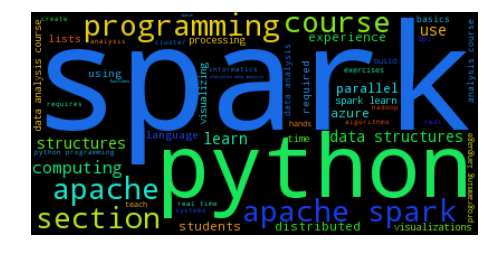

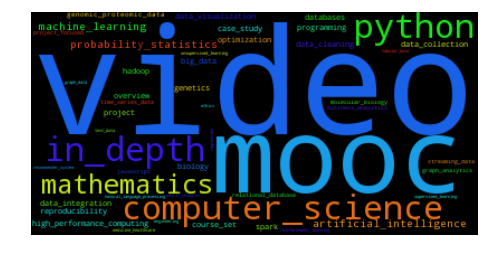

--------------------------------------------------------------------------------
# resources: 95


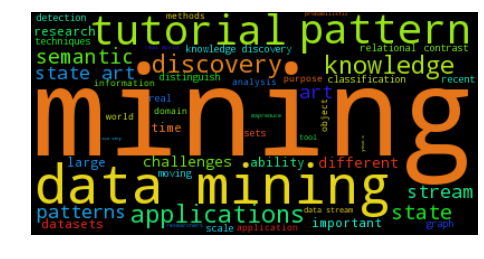

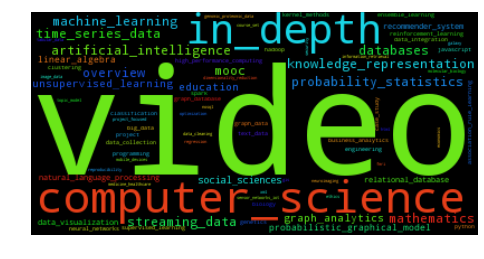

In [5]:
clf = CLF(n_topics=30, tag_vec_min_df=1, tag_vec_max_df=1., nmf=True, n_estimators=12, class_weight='balanced', n_jobs=-1)
print('# resources:', len(df))
print('tagged resources:', (df['tag'].apply(len) > 0).sum())
clf.fit(df[['title', 'subtitle', 'description', 'syllabus']], df['tag'], 
        viz=True)
print(clf.score(df[['title', 'subtitle', 'description', 'syllabus']], df['tag']))
clf.plot_word_and_tag_clouds(df[['title', 'subtitle', 'description', 'syllabus']], df['tag'], th=.01)

In [6]:
df = df.reindex(np.random.permutation(df.index))

In [31]:
df_vec = clf.transform(df[['title', 'subtitle', 'description', 'syllabus']])
c = 0
for (idx, row), vec in zip(df.iterrows(), df_vec):
    c += 1
    if c > 10:
        break
    print('=' * 80)
    print(row['title'])
    print('-' * 80)
    print(row['tag'])
    print('-' * 80)
    print(row['description'])
    fig, ax = plt.subplots(1, 2, figsize=(14, 8))
    res_topics = list()
    for ax_idx, (val_idx, val) in enumerate(sorted(enumerate(vec), key=itemgetter(1), reverse=True)[:2]):
        #print(val_idx, val)
        wordcloud(clf.topic_dict[val_idx], ax=ax[ax_idx])
        ax[ax_idx].set_title("%.3f" % val)
        ax[ax_idx].axis("off")
        res_topics.append(val_idx)
    print(' ,'.join('t'+ str(i) for i in res_topics))
    plt.show()

IndentationError: expected an indented block (<ipython-input-31-143a746078aa>, line 6)

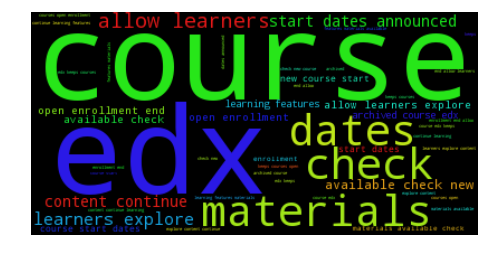

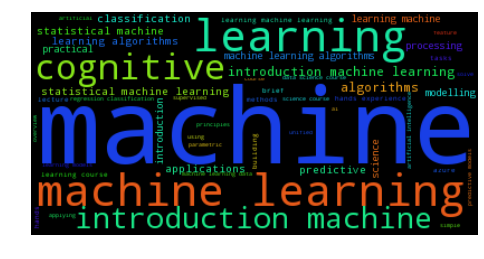

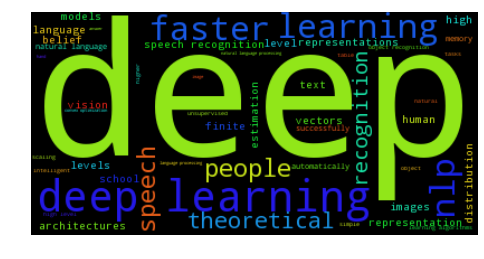

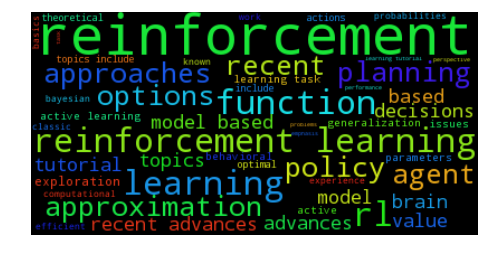

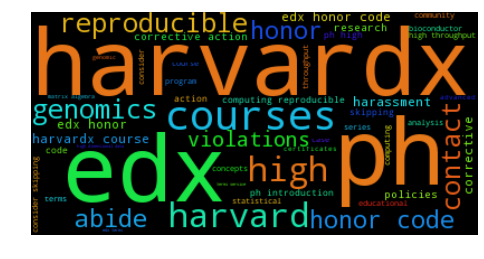

...

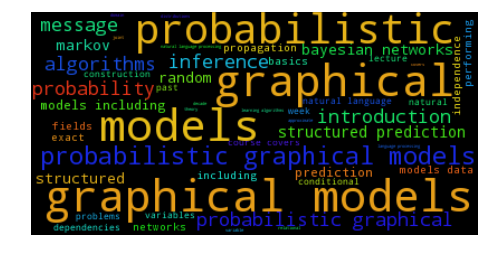

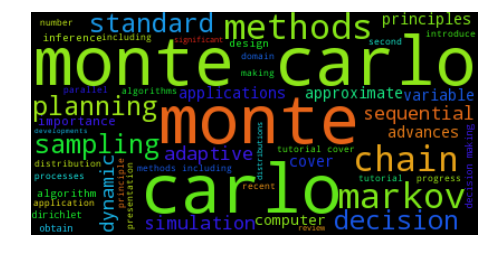

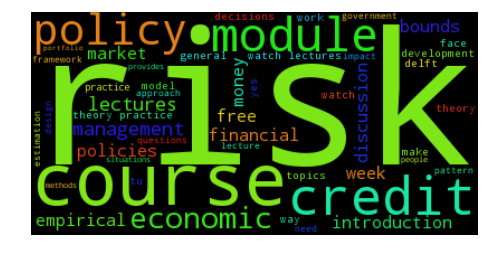

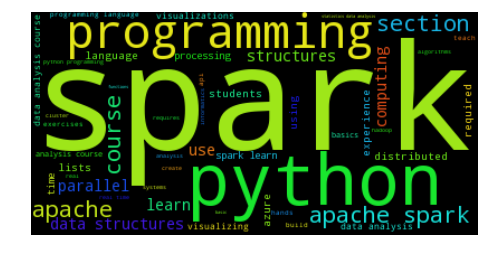

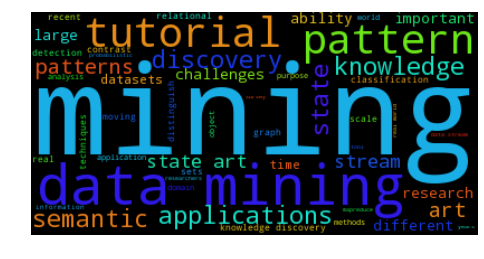

In [8]:
if not os.path.isdir('topics_ids/'):
    os.makedirs('topics_ids/')
for t_id in range(30):
    print('=' * 80)
    wordcloud(clf.topic_dict[t_id])
    plt.savefig('topics_ids/' + str(t_id) + '.png')

d = list()
for (idx, row), vec in zip(df.iterrows(), df_vec):
    d.append(tuple([row['id']] + list(vec)))
pd.DataFrame(columns=['id'] + list(map(str, range(30))), data=d).to_csv('topics_ids/topic_assignments.csv', 
                                                                        index=False)

In [36]:
scores = list()
for n_topics in tqdm(range(5, 70, 5)):
    clf = CLF(n_topics=n_topics, tag_vec_min_df=5, nmf=True)
    clf.fit(df[['title', 'subtitle', 'description', 'syllabus']], df['tag'], 
            viz=False)
    #s = clf.score(df[['title', 'subtitle', 'description', 'syllabus']], df['tag'])
    s = clf.nmf.reconstruction_err_
    scores.append((n_topics, s))

100%|██████████| 13/13 [00:52<00:00,  6.40s/it]


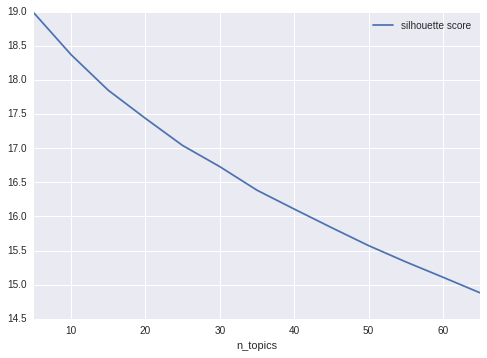

In [37]:
pd.DataFrame(columns=['n_topics', 'silhouette score'], data=scores).plot(x='n_topics')
plt.show()

In [11]:
df.head(2)

,id,description,title,subtitle,syllabus,tag,all_tag,fold_num
171,http://videolectures.net/nips09_doucet_freitas...,"Over the last fifteen years, sequential Monte ...",Sequential Monte-Carlo Methods - VideoLectures...,NaN,NaN,mathematics probability_statistics video in_depth,resource_depth>in_depth | knowledge_domain>mat...,0
354,https://www.edx.org/course/introduction-python...,Python is a very powerful programming language...,Introduction to Python for Data Science,The ability to analyze data with Python is cri...,Course Syllabus \n Section 1: Python Basics \n...,computer_science MOOC Python overview programm...,data_science_process>data_visualization | reso...,2
137,http://videolectures.net/mlss08au_kotagiri_dami/,"The ability to distinguish, differentiate and ...",Contrast Data Mining: Methods and Applications...,NaN,NaN,computer_science video probability_statistics ...,resource_depth>in_depth | data_science_process...,0
304,https://www.edx.org/course/big-data-education-...,This is an Archived Course \n EdX keeps course...,Big Data in Education,Learn how and when to use key methods for educ...,NaN,computer_science MOOC social_sciences video pr...,knowledge_domain>social_sciences>education | r...,3
32,http://videolectures.net/deeplearning2015_lee_...,NaN,Stacks of Restricted Boltzmann Machines - Vide...,NaN,NaN,computer_science reinforcement_learning unsupe...,resource_depth>in_depth | data_science_process...,3
151,http://videolectures.net/mlss09uk_shawe_taylor...,NaN,Learning Theory - VideoLectures.NET,NaN,NaN,computer_science video probability_statistics ...,resource_depth>in_depth | data_science_process...,4
291,http://www.coursera.org/learn/wharton-introduc...,The simple spreadsheet is one of the most powe...,Introduction to Spreadsheets and Models,NaN,NaN,MOOC video business_analytics tabular_data,knowledge_domain>business_analytics | resource...,1
366,https://www.edx.org/course/marketing-analytics...,This is an Archived Course \n EdX keeps course...,Marketing Analytics: Marketing Measurement Str...,Learn best approaches and practices for market...,NaN,overview MOOC video business_analytics,knowledge_domain>business_analytics | resource...,1
164,http://videolectures.net/mlss2011_green_bayesian/,Inference is the process of discovering from d...,Bayesian Inference - VideoLectures.NET,NaN,NaN,computer_science unsupervised_learning video p...,resource_depth>in_depth | data_science_process...,0
128,http://videolectures.net/mlss06tw_bartlett_pclmc/,These lectures will provide an introduction to...,Pattern Classification and Large Margin Classi...,NaN,NaN,computer_science video probability_statistics ...,resource_depth>in_depth | data_science_process...,3


In [ ]:
#df[['title', 'subtitle', 'description', 'syllabus']]

In [16]:
import difflib
def overlaps(s1, s2):
    s = difflib.SequenceMatcher(None, s1, s2)
    for m in sorted(s.get_matching_blocks(), key=lambda x:x[2], reverse=True):
        pos_a, pos_b, size = m
        yield s1[pos_a:pos_a+size]

min_occurence = 5
min_overlap = 8
columns = ['title', 'subtitle', 'description', 'syllabus']

for col in columns:
    text = df[col].apply(text_cleanup)
    i_range = range(len(text))
    j_range = range(len(text))
    random.shuffle(i_range)
    random.shuffle(j_range)
    for i in tqdm(i_range, desc=col):
        s1 = text.iloc[i]
        if not isinstance(s1, str):
            continue
        for j in j_range:
            if i != j and i < j:
                s2 = text.iloc[j]
                if not isinstance(s2, str):
                    continue
                for overlap in overlaps(s1, s2):
                    if len(overlap.split()) >= min_overlap:
                        occurence = text.apply(lambda x: overlap in x).sum()
                        if occurence >= min_occurence:
                            print('remove overlap occured in', occurence, '\n', overlap)
                            text = text.apply(lambda x: x.replace(overlap, ' '))
    df[col] = text

syllabus: 100%|██████████| 413/413 [00:37<00:00,  4.88it/s]


# resources: 413
tagged resources: 413
v v v v 	Topic #0	v v v v v

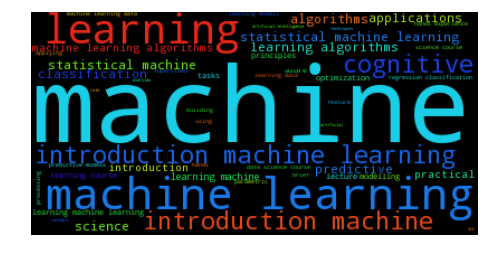

v v v v 	Topic #1	v v v v v

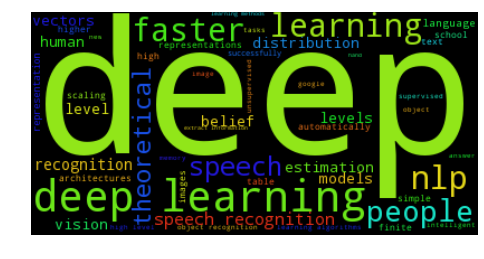

v v v v 	Topic #2	v v v v v

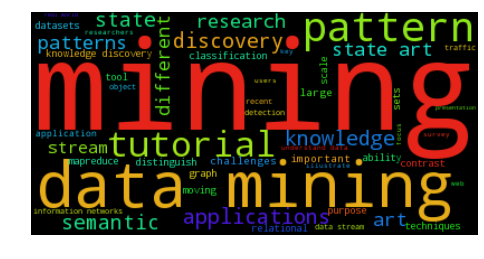

v v v v 	Topic #3	v v v v v

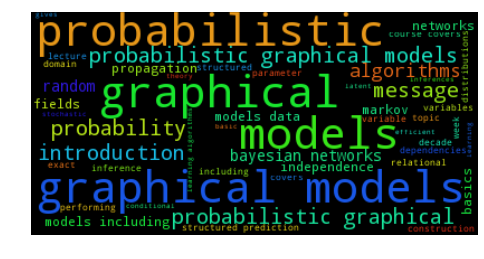

v v v v 	Topic #4	v v v v v

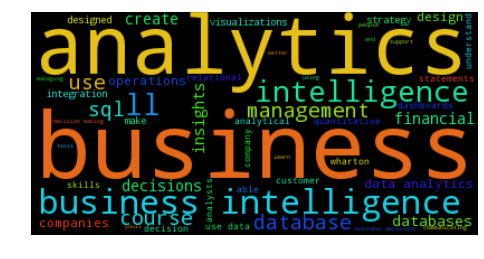

v v v v 	Topic #5	v v v v v

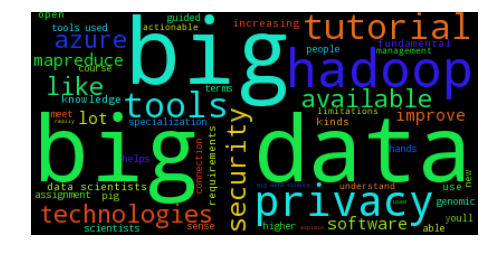

v v v v 	Topic #6	v v v v v

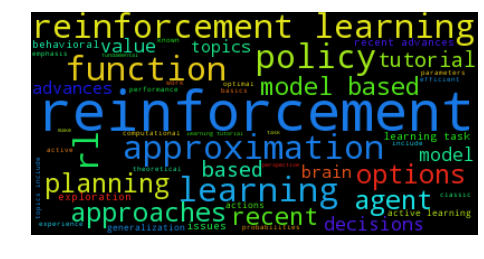

v v v v 	Topic #7	v v v v v

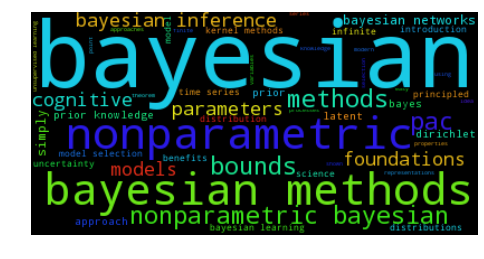

v v v v 	Topic #8	v v v v v

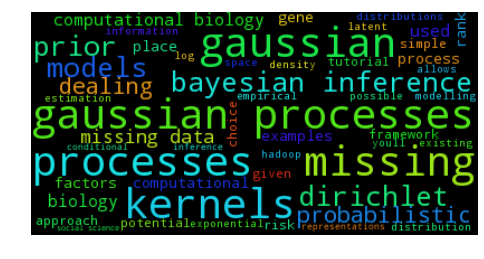

v v v v 	Topic #9	v v v v v

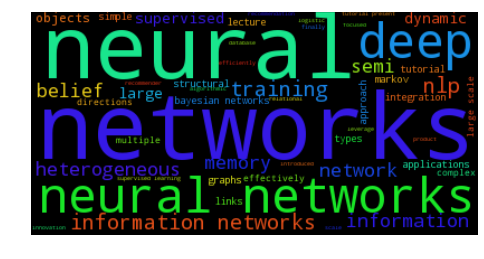

v v v v 	Topic #10	v v v v v

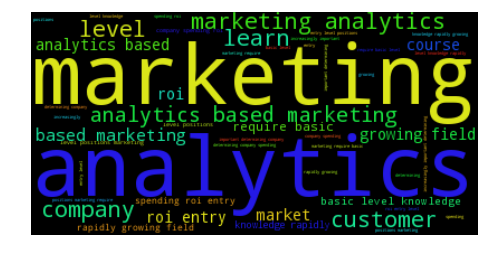

v v v v 	Topic #11	v v v v v

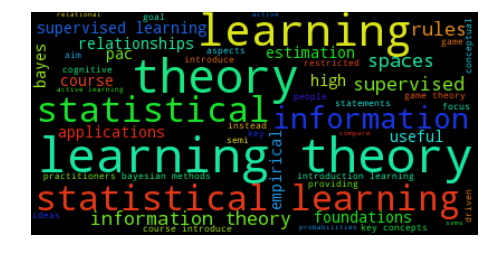

v v v v 	Topic #12	v v v v v

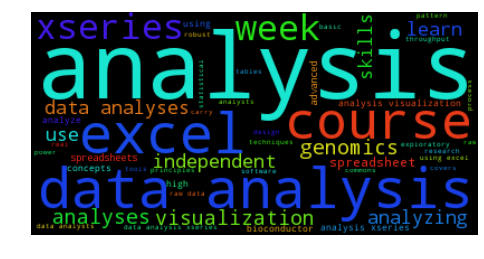

v v v v 	Topic #13	v v v v v

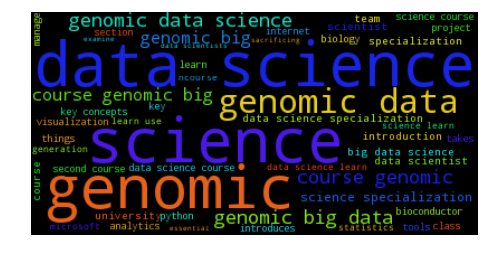

v v v v 	Topic #14	v v v v v

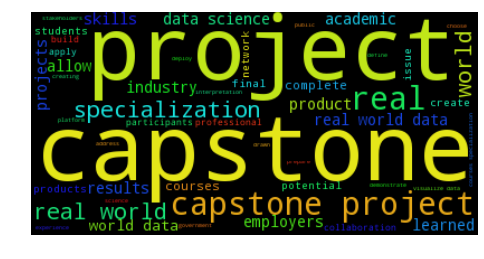

v v v v 	Topic #15	v v v v v

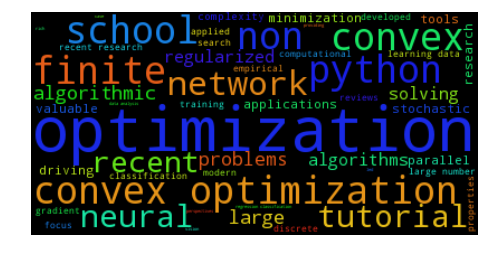

v v v v 	Topic #16	v v v v v

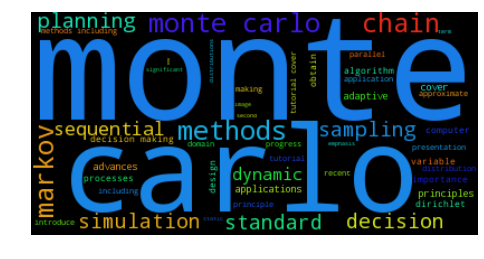

v v v v 	Topic #17	v v v v v

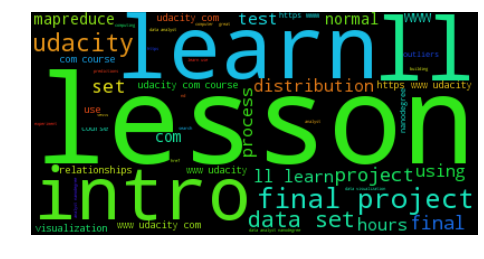

v v v v 	Topic #18	v v v v v

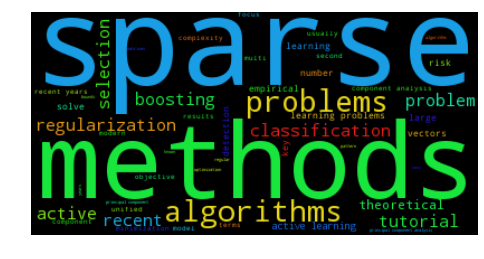

v v v v 	Topic #19	v v v v v

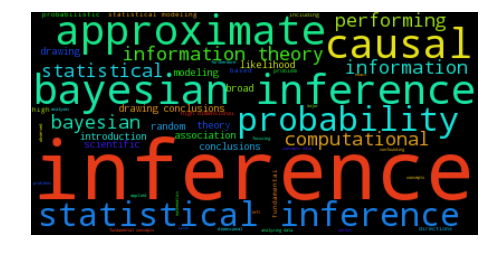

v v v v 	Topic #20	v v v v v

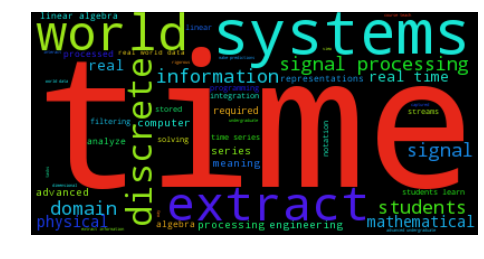

v v v v 	Topic #21	v v v v v

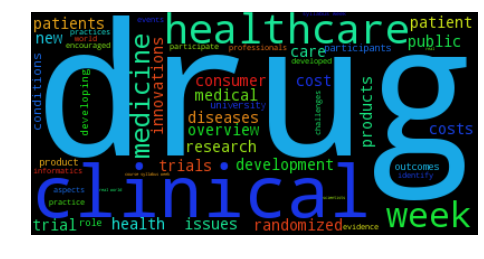

v v v v 	Topic #22	v v v v v

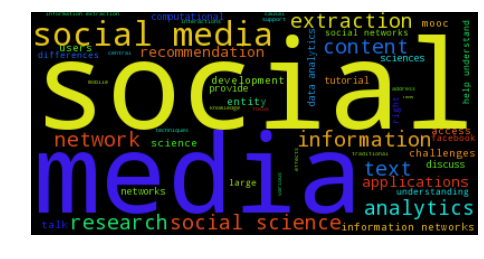

v v v v 	Topic #23	v v v v v

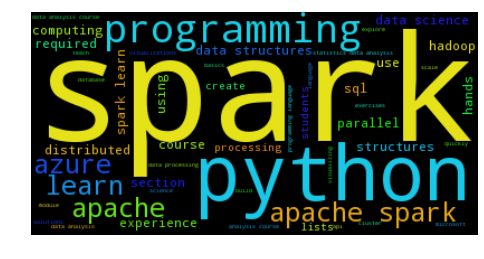

v v v v 	Topic #24	v v v v v

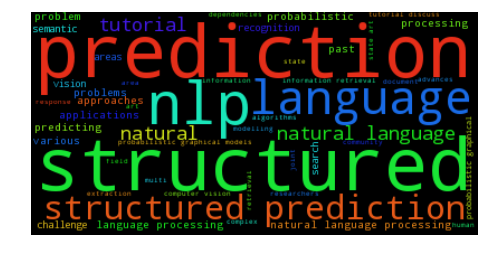

v v v v 	Topic #25	v v v v v

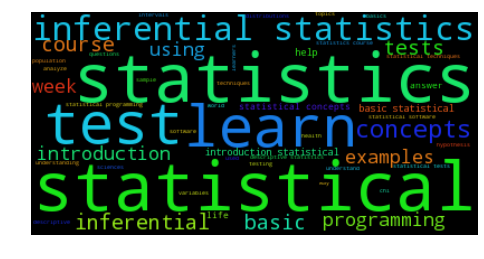

v v v v 	Topic #26	v v v v v

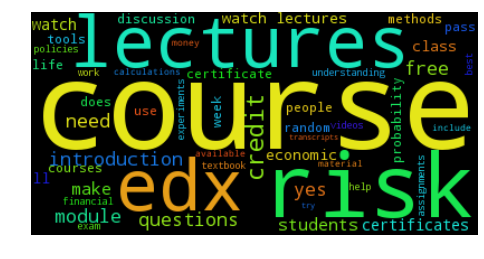

v v v v 	Topic #27	v v v v v

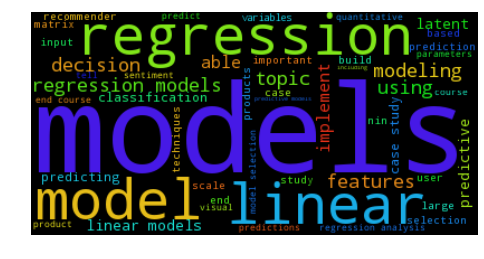

v v v v 	Topic #28	v v v v v

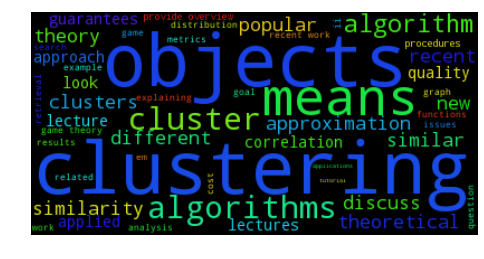

v v v v 	Topic #29	v v v v v

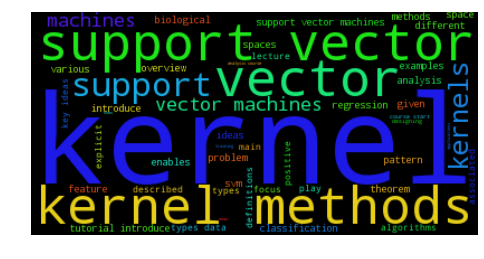

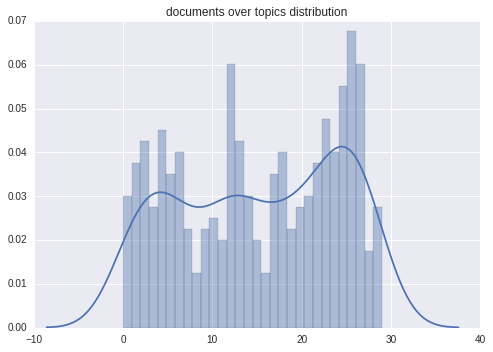

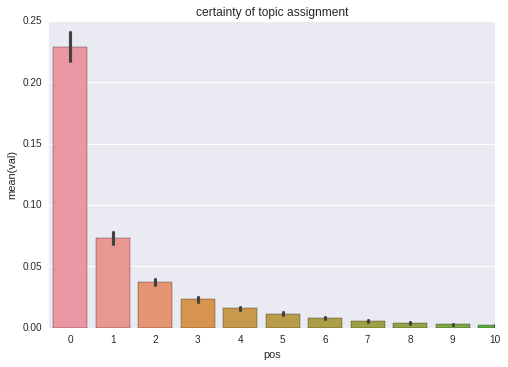

413


0.254650073741


In [ ]:
clf = CLF(n_topics=30, tag_vec_min_df=1, tag_vec_max_df=1., nmf=True, n_estimators=12, class_weight='balanced', n_jobs=-1)
print('# resources:', len(df))
print('tagged resources:', (df['tag'].apply(len) > 0).sum())
clf.fit(df[['title', 'subtitle', 'description', 'syllabus']], df['tag'], 
        viz=True)
print(clf.score(df[['title', 'subtitle', 'description', 'syllabus']], df['tag']))
#clf.plot_word_and_tag_clouds(df[['title', 'subtitle', 'description', 'syllabus']], df['tag'], th=.01)

sequential monte carlo methods 
--------------------------------------------------------------------------------
mathematics probability_statistics video in_depth
--------------------------------------------------------------------------------
over the last fifteen years sequential monte carlo smc methods gained popularity as powerful tools for solving intractable inference problems arising in the modelling of sequential data much effort was devoted to the development of smc methods known as particle filters pfs for estimating the filtering distribution of the latent variables in dynamic models this line of research produced many algorithms including auxiliary variable pfs marginal pfs the resample move algorithm and rao blackwellised pfs it also led to many applications in tracking computer vision robotics and econometrics the theoretical properties of these methods were also studied extensively in this period although pfs occupied the center stage significant progress was also attain

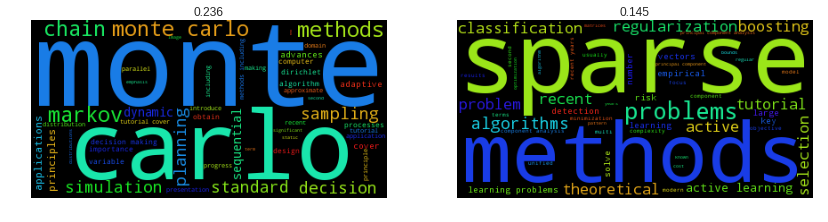

introduction to python for data science
--------------------------------------------------------------------------------
computer_science MOOC Python overview programming video data_visualization in_depth
--------------------------------------------------------------------------------
python is a very powerful programming language used for many different applications over time the huge community around this open source language has created quite a few tools to efficiently work with python in recent years a number of tools have been built specifically for data science as a result analyzing data with python has never been easier in this practical course you will start from the very beginning with basic arithmetic and variables and learn how to handle data structures such as python lists numpy arrays and pandas dataframes along the way you ll learn about python functions and control flow plus you ll look at the world of data visualizations with python and create your own stunning visualiz

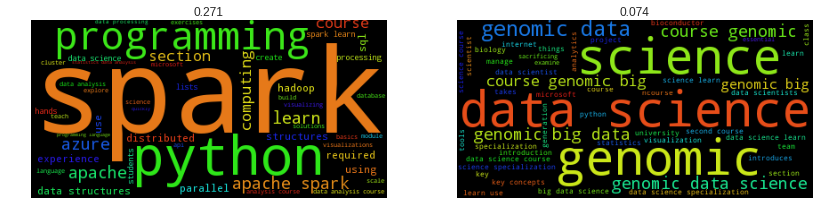

contrast data mining methods and applications 
--------------------------------------------------------------------------------
computer_science video probability_statistics machine_learning mathematics artificial_intelligence in_depth
--------------------------------------------------------------------------------
the ability to distinguish differentiate and contrast between different datasets is a key objective in data mining such an ability can assist domain experts to understand their data and can help in building classification models his presentation will introduce the principal techniques for contrasting different types of data covering the main dataset varieties such as relational sequence and graph forms of data clusters as well as data cubes it will also focus on some important real world application areas that illustrate how mining contrasts is advantageous 
t2 ,t27


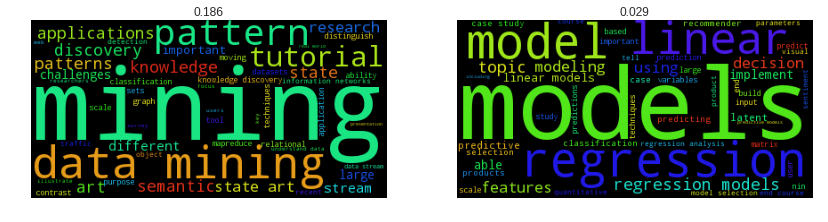

big data in education
--------------------------------------------------------------------------------
computer_science MOOC social_sciences video probability_statistics machine_learning mathematics education artificial_intelligence in_depth
--------------------------------------------------------------------------------
 education is increasingly occurring online or in educational software resulting in an explosion of data that can be used to improve educational effectiveness and support basic research on learning in this course you will learn how and when to use key methods for educational data mining and learning analytics on this data you will learn about the methods being developed by researchers in the educational data mining learning analytics learning at scale student modeling and artificial intelligence in education communities as well as standard data mining methods frequently applied to educational data you will learn how to apply these methods and when to apply them as well

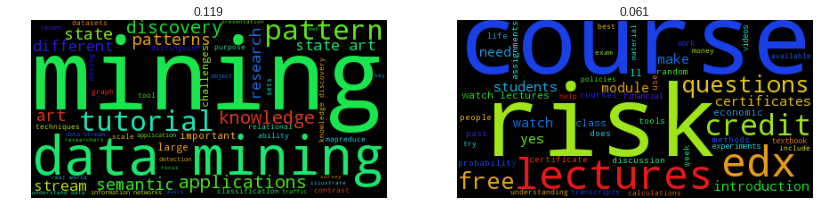

stacks of restricted boltzmann machines 
--------------------------------------------------------------------------------
computer_science reinforcement_learning unsupervised_learning video neural_networks probability_statistics machine_learning mathematics artificial_intelligence in_depth
--------------------------------------------------------------------------------

t29 ,t24


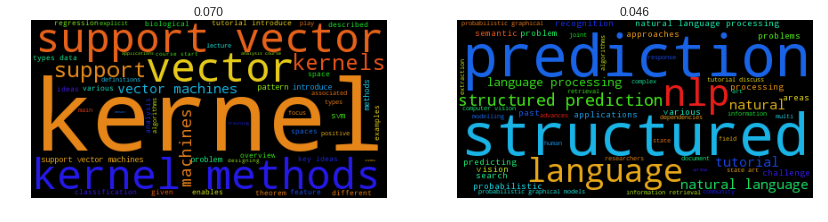

learning theory 
--------------------------------------------------------------------------------
computer_science video probability_statistics machine_learning mathematics artificial_intelligence in_depth
--------------------------------------------------------------------------------

t11 ,t1


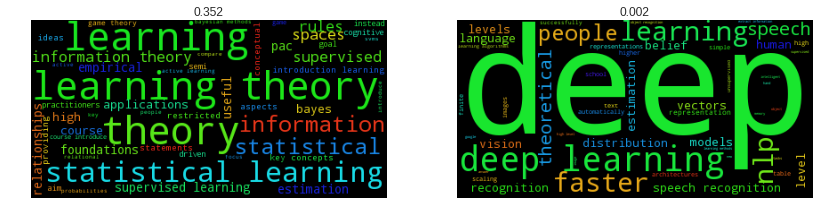

introduction to spreadsheets and models
--------------------------------------------------------------------------------
MOOC video business_analytics tabular_data
--------------------------------------------------------------------------------
the simple spreadsheet is one of the most powerful data analysis tools that exists and it s available to almost anyone major corporations and small businesses alike use spreadsheet models to determine where key measures of their success are now and where they are likely to be in the future but in order to get the most out of a spreadsheet you have know how to use it this course is designed to give you an introduction to basic spreadsheet tools and formulas so that you can begin harness the power of spreadsheets to map the data you have now and to predict the data you may have in the future through short easy to follow demonstrations you ll learn how to use excel or sheets so that you can begin to build models and decision trees in future courses

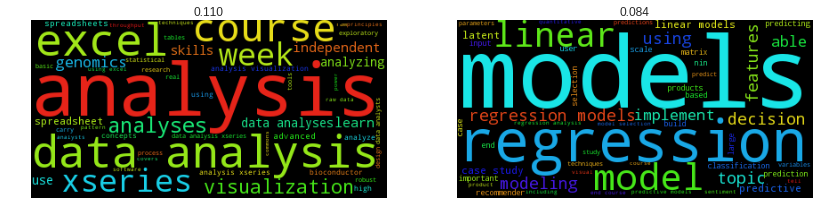

marketing analytics marketing measurement strategy
--------------------------------------------------------------------------------
overview MOOC video business_analytics
--------------------------------------------------------------------------------
 begin your journey in a new career in marketing analytics learn about powerful strategies and methodology starting with identifying market trends and metrics used to measure marketing success in this marketing course you will learn how to execute market sizing identify market trends and predict future conditions this course course analytics based marketing is increasingly important in determining a company s spending and roi many entry level positions in marketing now require some basic level of knowledge in this rapidly growing field 
t10 ,t0


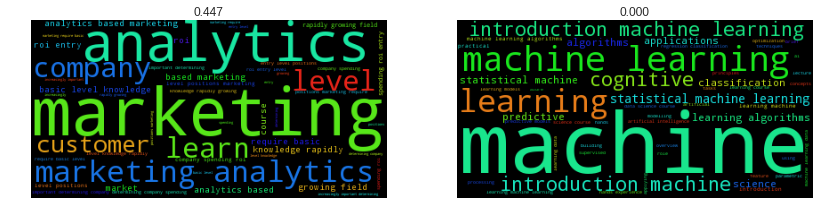

bayesian inference 
--------------------------------------------------------------------------------
computer_science unsupervised_learning video probability_statistics machine_learning mathematics artificial_intelligence in_depth
--------------------------------------------------------------------------------
inference is the process of discovering from data about mechanisms that may have caused or generated that data or at least explain it the goals are varied perhaps simply predicting future data or more ambitiously drawing conclusions about scientific or societal truths in the language of applied mathematics these are inverse problems bayesian inference is about using probability to do all this one of its strengths is that all sources of uncertainty in a problem can be simultaneously and coherently considered it is model based in the language of machine learning these are generative models and we can use bayesian methods to choose and criticize the models we use 
t19 ,t7


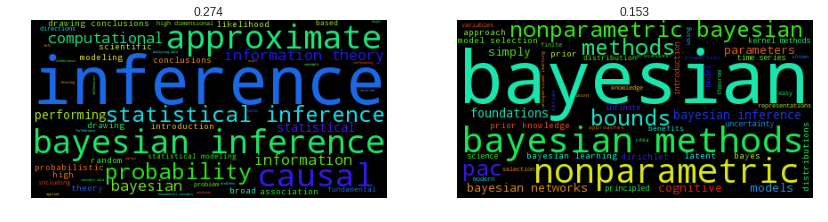

pattern classification and large margin classifiers 
--------------------------------------------------------------------------------
computer_science video probability_statistics machine_learning mathematics artificial_intelligence in_depth
--------------------------------------------------------------------------------
these lectures will provide an introduction to the theory of pattern classification methods they will focus on relationships between the minimax performance of a learning system and its complexity there will be four lectures the first will review the formulation of the pattern classification problem and several popular pattern classification methods and present general risk bounds in terms of rademacher averages a measure of the complexity of a class of functions the second lecture will consider pattern classification in a minimax setting and show that in this setting the vapnik chervonenkis dimension is the key measure of complexity the third lecture will focus on a t

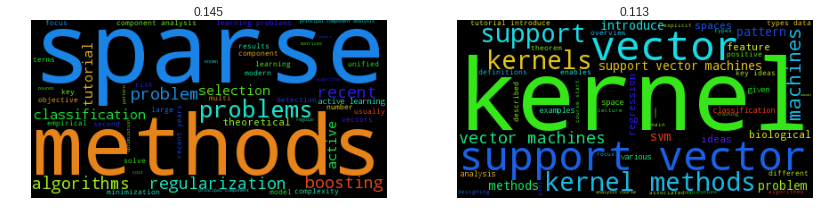

programming with r for data science
--------------------------------------------------------------------------------
overview MOOC R video data_visualization
--------------------------------------------------------------------------------
in this computer science course from microsoft developed in collaboration with the technical university of denmark dtu get the knowledge and skills you need to use r the statistical programming language for data scientists in the field of your choice in this course you will learn all you need to get up to speed with programming in r explore r data structures and syntaxes see how to read and write data from a local file to a cloud hosted database work with data get summaries and transform them to fit your needs plus find out how to perform predictive analytics using r and how to create visualizations using the popular ggplot package 
t23 ,t25


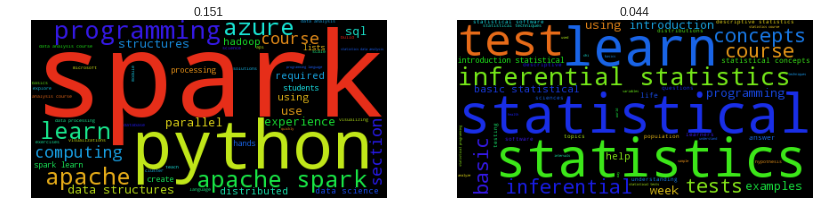

wharton business and financial modeling capstone
--------------------------------------------------------------------------------
MOOC video business_analytics project_focused
--------------------------------------------------------------------------------
in this capstone you will recommend a business strategy based on a data models you ve constructed using a dataset from wharton research data services wrds you will implement quantitative models in spreadsheets to identify the best opportunities for success and minimizing risk using your newly acquired decision making skills you will structure a decision and present this course of action in a professional quality powerpoint presentation which includes both data and data analysis from your quantitative models n nwharton research data services wrds is the leading data research platform and business intelligence tool for over corporate academic government and nonprofit clients in countries wrds provides the user with one location to acce

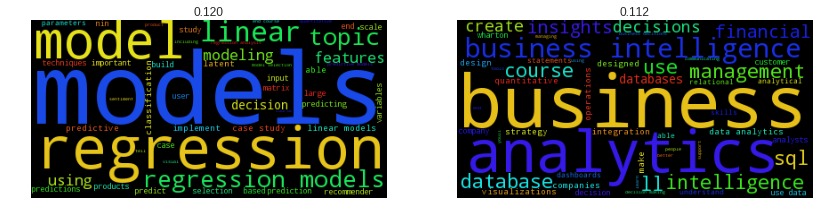

econometrics methods and applications
--------------------------------------------------------------------------------
MOOC overview economics time_series_data business_analytics project video probability_statistics mathematics
--------------------------------------------------------------------------------
welcome ndo you wish to know how to analyze and solve business and economic questions with data analysis tools then econometrics by erasmus university rotterdam is the right course for you as you learn how to translate data into models to make forecasts and to support decision making n n what do i learn nwhen you know econometrics you are able to translate data into models to make forecasts and to support decision making in a wide variety of fields ranging from macroeconomics to finance and marketing our course starts with introductory lectures on simple and multiple regression followed by topics of special interest to deal with model specification endogenous variables binary choice

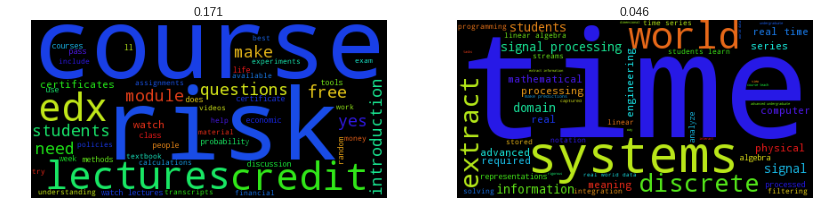

machine learning recommender systems dimensionality reduction
--------------------------------------------------------------------------------
computer_science MOOC Python dimensionality_reduction recommender_system unsupervised_learning video probability_statistics machine_learning mathematics artificial_intelligence in_depth
--------------------------------------------------------------------------------
case study recommending products n nhow does amazon recommend products you might be interested in purchasing how does netflix decide which movies or tv shows you might want to watch what if you are a new user should netflix just recommend the most popular movies who might you form a new link with on facebook or linkedin these questions are endemic to most service based industries and underlie the notion of collaborative filtering and the recommender systems deployed to solve these problems in this fourth case study you will explore these ideas in the context of recommending products 

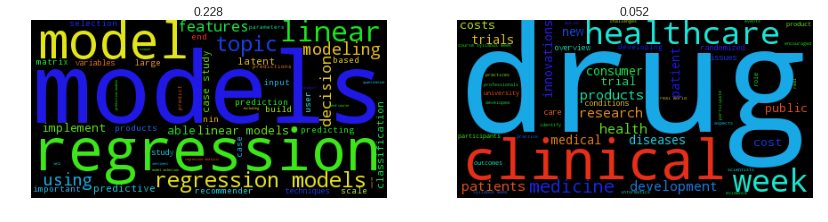

algorithms for interpretable machine learning 
--------------------------------------------------------------------------------
computer_science video probability_statistics machine_learning mathematics artificial_intelligence in_depth
--------------------------------------------------------------------------------
it is extremely important in many application domains to have transparency in predictive modeling domain experts do not tend to prefer black box predictive models they would like to understand how predictions are made and possibly prefer models that emulate the way a human expert might make a decision with a few important variables and a clear convincing reason to make a particular prediction i will discuss recent work on interpretable predictive modeling with decision lists and sparse integer linear models i will describe several approaches including an algorithm based on discrete optimization and an algorithm based on bayesian analysis i will show examples of interpretable

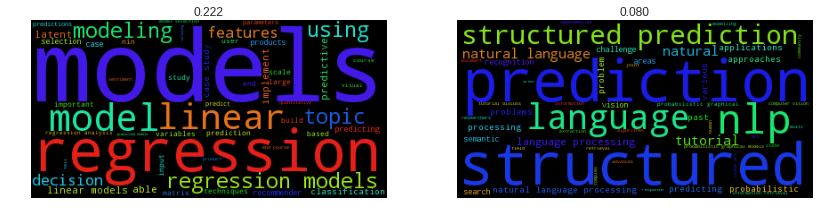

introduction to apache spark
--------------------------------------------------------------------------------
computer_science high_performance_computing Python overview MOOC video Spark
--------------------------------------------------------------------------------
spark is rapidly becoming the compute engine of choice for big data spark programs are more concise and often run times faster than hadoop mapreduce jobs as companies realize this spark developers are becoming increasingly valued this statistics and data analysis course will teach you the basics of working with spark and will provide you with the necessary foundation for diving deeper into spark you ll learn about spark s architecture and programming model including commonly used apis after completing this course you ll be able to write and debug basic spark applications this course will also explain how to use spark s web user interface ui how to recognize common coding errors and how to proactively prevent errors the foc

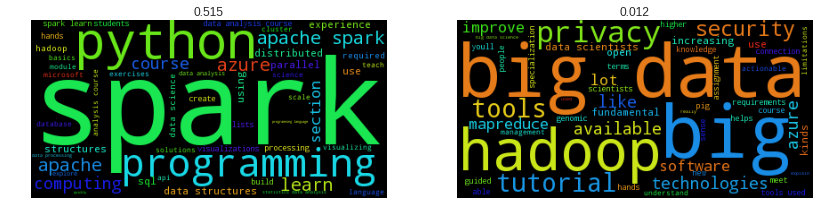

scale out beyond mapreduce 
--------------------------------------------------------------------------------
computer_science video probability_statistics machine_learning mathematics artificial_intelligence in_depth
--------------------------------------------------------------------------------
the amount of data being collected is growing at a staggering pace the default is to capture and store any and all data in anticipation of potential future strategic value and vast amounts of data are being generated by instrumenting key customer and systems touchpoints until recently data was gathered for well defined objectives such as auditing forensics reporting and line of business operations now exploratory and predictive analysis is becoming ubiquitous these differences in data scale and usage are leading to a new generation of data management and analytic systems where the emphasis is on supporting a wide range of data to be stored uniformly and analyzed seamlessly using whatever techn

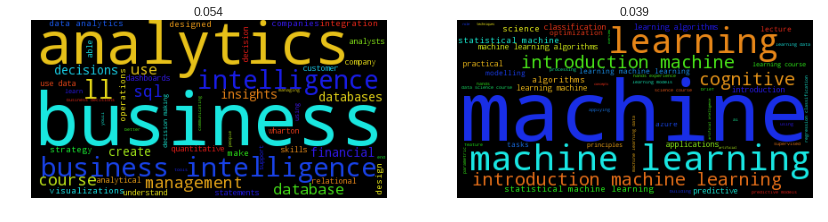

security privacy and big data standards 
--------------------------------------------------------------------------------
computer_science big_data security video in_depth
--------------------------------------------------------------------------------

t5 ,t0


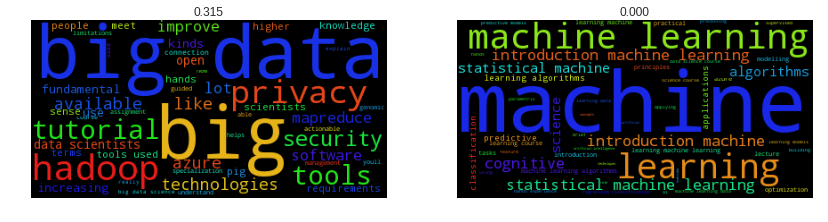

mining heterogeneous information networks 
--------------------------------------------------------------------------------
computer_science video probability_statistics machine_learning mathematics artificial_intelligence in_depth
--------------------------------------------------------------------------------
most objects and data in the real world are of multiple types interconnected forming complex heterogeneous but often semi structured information networks however most network science researchers are focused on homogeneous networks without distinguishing different types of objects and links in the networks we view interconnected multityped data including the typical relational database data as heterogeneous information networks study how to leverage the rich semantic meaning of structural types of objects and links in the networks and develop a structural analysis approach on mining semi structured multi typed heterogeneous information networks in this article we summarize a set 

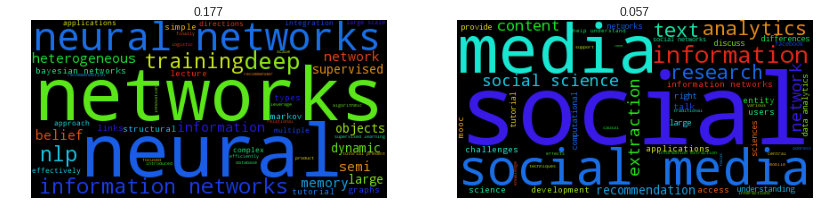

mathematical biostatistics boot camp 
--------------------------------------------------------------------------------
overview MOOC probability_statistics video mathematics
--------------------------------------------------------------------------------
learn fundamental concepts in data analysis and statistical inference focusing on one and two independent samples 
t19 ,t12


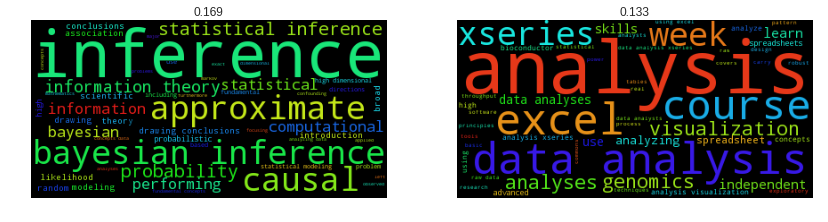

deep generative models 
--------------------------------------------------------------------------------
computer_science reinforcement_learning unsupervised_learning video neural_networks probability_statistics machine_learning mathematics artificial_intelligence in_depth
--------------------------------------------------------------------------------

t1 ,t27


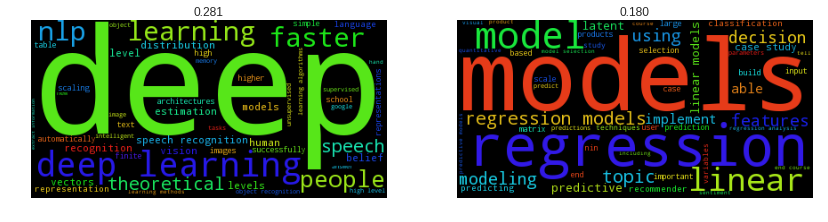

data science orientation
--------------------------------------------------------------------------------
overview MOOC video tabular_data
--------------------------------------------------------------------------------
learn what it takes to become a data scientist this is the first stop in the data science curriculum from microsoft it will help you get started with the program plan your learning schedule and connect with fellow students and teaching assistants along the way you ll get an introduction to working with and exploring data using a variety of visualization analytical and statistical techniques 
t13 ,t25


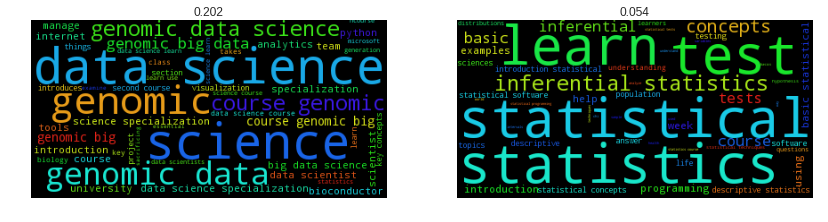

algorithms for dna sequencing
--------------------------------------------------------------------------------
biology molecular_biology genomic_proteomic_data Python MOOC data_integration video genetics data_cleaning in_depth
--------------------------------------------------------------------------------
we will learn computational methods algorithms and data structures for analyzing dna sequencing data we will learn a little about dna genomics and how dna sequencing is used we will use python to implement key algorithms and data structures and to analyze real genomes and dna sequencing datasets 
t23 ,t18


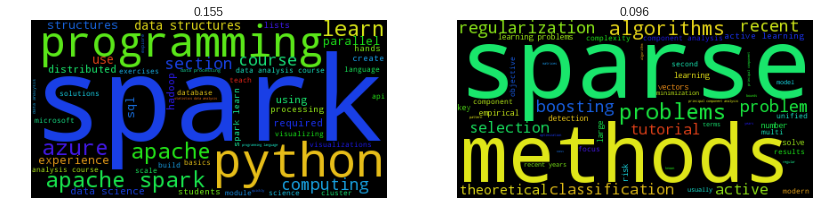

sabermetrics introduction to baseball analytics
--------------------------------------------------------------------------------
computer_science MOOC relational_database overview databases R video probability_statistics mathematics case_study
--------------------------------------------------------------------------------
 this course will cover the theory and the fundamentals of the emerging science of sabermetrics we will discuss the game of baseball not through consensus or a fan s conventional wisdom but by searching for objective knowledge in baseball performance these and other areas of sabermetrics will be analyzed and better understood with current and historical baseball data the course also serves as applied introduction to the basics of data science an emerging field of scholarship that requires skills in computation statistics and communicating results of analyses using baseball data the basics of statistical regression the r language and sql will be covered this course wa

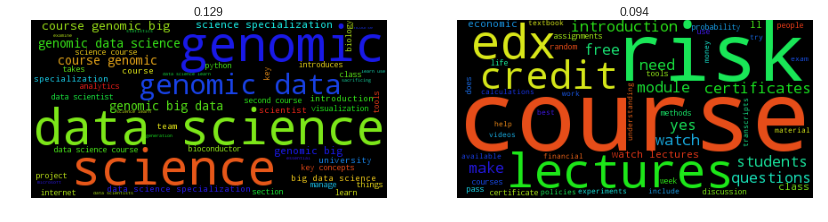

machine learning probability and graphical models 
--------------------------------------------------------------------------------
computer_science video probability_statistics machine_learning mathematics probabilistic_graphical_model artificial_intelligence in_depth
--------------------------------------------------------------------------------

t3 ,t0


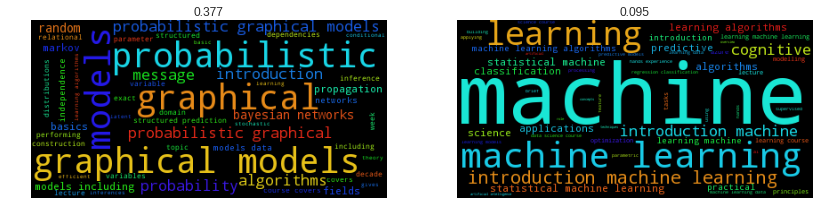

machine learning with big data
--------------------------------------------------------------------------------
computer_science high_performance_computing overview MOOC big_data video probability_statistics machine_learning mathematics Spark artificial_intelligence
--------------------------------------------------------------------------------
want to learn the basics of large scale data processing need to make predictive models but don t know the right tools this course will introduce you to open source tools you can use for parallel distributed and scalable machine learning after completing this course s hands on projects with knime and spark you will be able to train evaluate and validate basic predictive models you will be able to describe and apply common clustering techniques and classification algorithms 
t23 ,t27


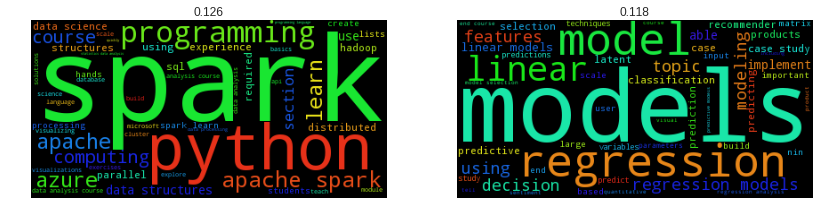

evaluating social programs
--------------------------------------------------------------------------------
MOOC data_collection economics social_sciences video case_study in_depth
--------------------------------------------------------------------------------
 learn why evaluations matter and how they can be used to rigorously measure the social impact of development programs this practical course will provide a thorough understanding of randomized evaluations with pragmatic step by step training for conducting one s own evaluation through a combination of lectures and case studies from real randomized evaluations the course will focus on the benefits and methods of randomization choosing an appropriate sample size and common threats and pitfalls to the validity of an experiment while the course is centered around the why how and when of randomized evaluations it will also impart insights on the importance of a needs assessment measuring outcomes effectively quality control and monit

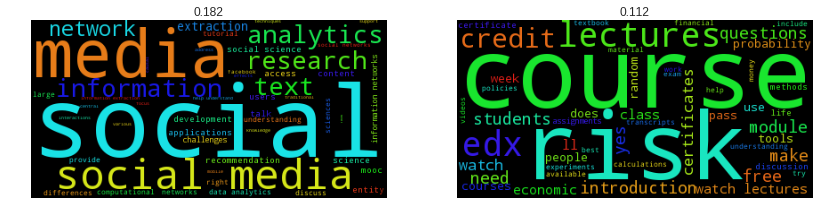

introduction to people analytics
--------------------------------------------------------------------------------
MOOC video business_analytics in_depth
--------------------------------------------------------------------------------
this course is designed to provide you with an understanding of the role of data and technology in human capital management every topic in the course will be covered in the most practical way so that learners get hands on experience in the course we use the ts principle task theory technique and technology so that there is always a connection to organizational performance objectives an overview of underlying theories and principles and specific tools which help achieve business objectives you will learn twhat combination of data technologies and tools can be used in people management processes to improve organization s performance thow to use some of these tools and how to select the ones that suit your objectives and budget tto design individual and team 

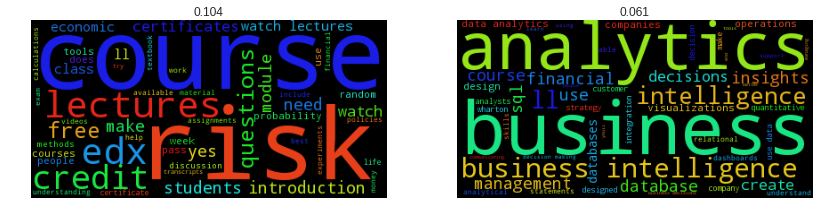

applications of linear algebra part 
--------------------------------------------------------------------------------
computer_science MOOC linear_algebra overview video probability_statistics machine_learning mathematics artificial_intelligence
--------------------------------------------------------------------------------
 from simulating complex phenomenon on supercomputers to storing the coordinates needed in modern d printing data is a huge and growing part of our world a major tool to manipulate and study this data is linear algebra this course is part of a part course in this part we ll learn basics of matrix algebra with an emphasis on application this class has a focus on computer graphics while also containing examples in data mining we ll learn to make an image transparent fade from one image to another and rotate a d wireframe model we ll also mine data for example we will find similar movies that one might enjoy seeing in the topic of sports ranking we ll be ready to part

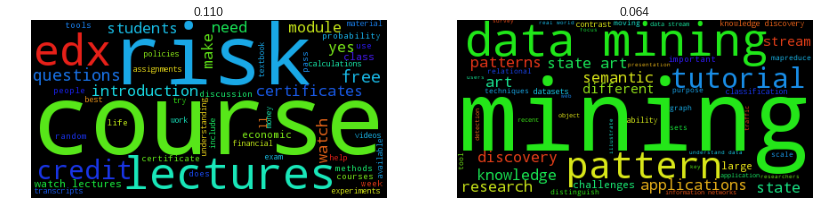

multilayer neural networks 
--------------------------------------------------------------------------------
computer_science reinforcement_learning unsupervised_learning video neural_networks probability_statistics machine_learning mathematics artificial_intelligence in_depth
--------------------------------------------------------------------------------

t9 ,t0


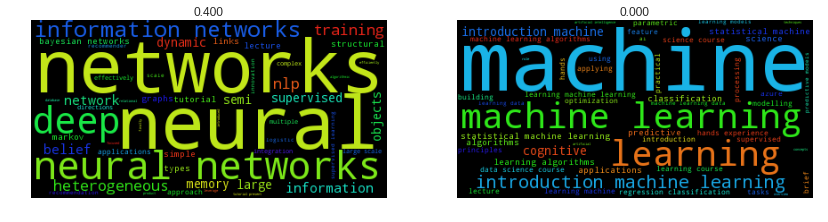

kernel methods and support vector machines 
--------------------------------------------------------------------------------
computer_science video probability_statistics machine_learning mathematics artificial_intelligence kernel_methods in_depth
--------------------------------------------------------------------------------
kernel methods have become a standard tool for pattern analysis during the last fifteen years since the introduction of support vector machines we will introduce the key ideas and indicate how this approach to pattern analysis enables a relatively easy plug and play application of different tools the problem of choosing and designing a kernel for specific types of data will also be considered and an overview of different kernels will be given 
t29 ,t12


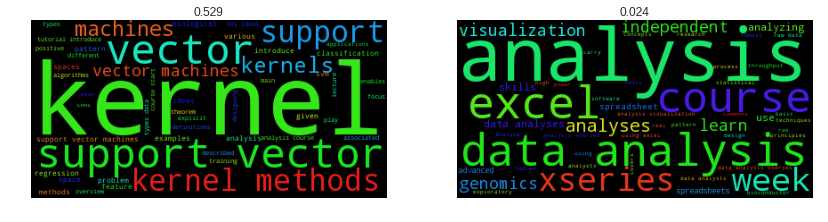

statistical aspects of pattern analysis 
--------------------------------------------------------------------------------
computer_science video probability_statistics machine_learning mathematics artificial_intelligence in_depth
--------------------------------------------------------------------------------
abstract the lectures will introduce the role of statistics in pattern analysis with a discussion of the difference between pattern significance and pattern stability we will go on to discuss composite hypothesis testing and the bonferroni correction concentration inequalities will be introduced and used to assess the statistical reliability of empirical estimates we move to consider uniform convergence in order to analyse pattern stability rademacher complexity will be discussed as a theoretical tool for the bounding of uniform convergence 
t25 ,t29


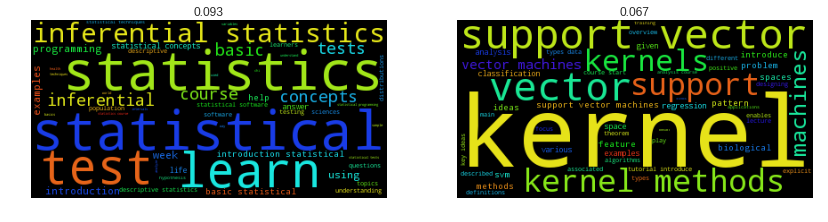

introduction to statistics probability
--------------------------------------------------------------------------------
overview MOOC probability_statistics video mathematics
--------------------------------------------------------------------------------
 statistics at berkeley is an introductory class taken by about students each year stat x is the second of three five week courses that make up stat x the online equivalent of berkeley s stat the focus of stat x is on probability theory exactly what is a random sample and how does randomness work if you buy lottery tickets instead of does your chance of winning go up by a factor of what is the law of averages how can polls make accurate predictions based on data from small fractions of the population what should you expect to happen just by chance these are some of the questions we will address in the course we will start with exact calculations of chances when the experiments are small enough that exact calculations are feasible and 

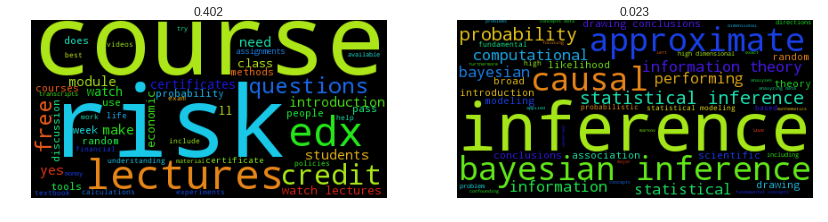

foundations of machine learning 
--------------------------------------------------------------------------------
computer_science video probability_statistics machine_learning mathematics artificial_intelligence in_depth
--------------------------------------------------------------------------------
machine learning is usually taught as a bunch of methods that can solve a bunch of problems see above the second part of the tutorial takes a step back and asks about the foundations of machine learning in particular the philosophical problem of inductive inference bayesian statistics and artificial intelligence it concentrates on principled unified and exact methods 
t0 ,t18


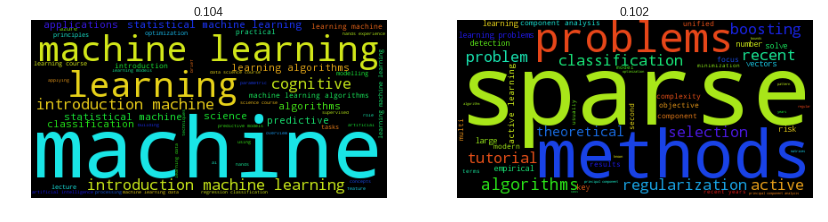

learning with probabilities 
--------------------------------------------------------------------------------
computer_science dimensionality_reduction unsupervised_learning video probability_statistics machine_learning mathematics artificial_intelligence in_depth
--------------------------------------------------------------------------------

t6 ,t11


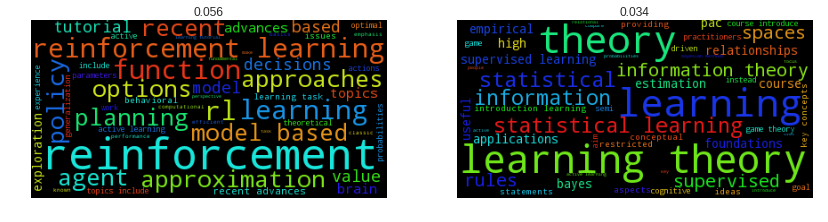

managing big data with mysql
--------------------------------------------------------------------------------
computer_science MOOC relational_database overview business_analytics video databases
--------------------------------------------------------------------------------
this course is an introduction to how to use relational databases in business analysis you will learn how relational databases work and how to use entity relationship diagrams to display the structure of the data held within them this knowledge will help you understand how data needs to be collected in business contexts and help you identify features you want to consider if you are involved in implementing new data collection efforts you will also learn how to execute the most useful query and table aggregation statements for business analysts and practice using them with real databases no more waiting hours for someone else in the company to provide data to you you will be able to get the data by yourself n nby t

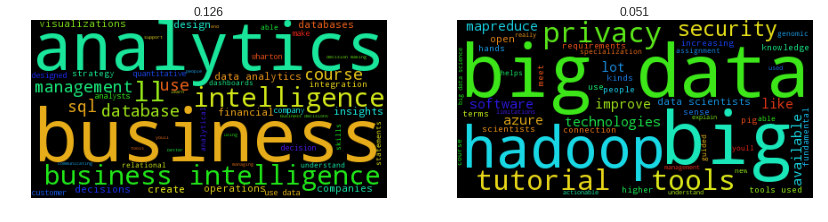

topic models 
--------------------------------------------------------------------------------
computer_science video probability_statistics machine_learning mathematics artificial_intelligence in_depth
--------------------------------------------------------------------------------

t27 ,t3


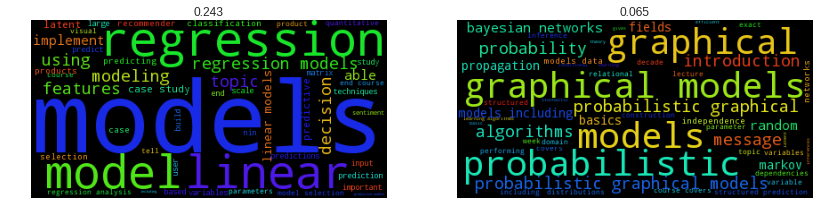

introduction to learning theory 
--------------------------------------------------------------------------------
computer_science video probability_statistics machine_learning mathematics artificial_intelligence in_depth
--------------------------------------------------------------------------------
the goal of this course is to introduce the key concepts of learning theory it will not be restricted to statistical learning theory but will mainly focus on statistical aspects instead of giving detailed proofs and precise statements this course will aim at providing some useful conceptual tools and ideas useful for practitioners as well as for theoretically driven people 
t11 ,t26


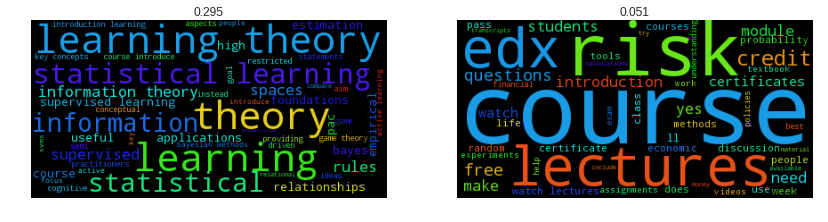

statistical thinking for data science and analytics
--------------------------------------------------------------------------------
MOOC data_collection overview data_visualization video probability_statistics mathematics
--------------------------------------------------------------------------------
this statistics and data analysis course will pave the statistical foundation for our discussion on data science you will learn how data scientists exercise statistical thinking in designing data collection derive insights from visualizing data obtain supporting evidence for data based decisions and construct models for predicting future trends from data this is the first course in the three part data science and analytics xseries 
t25 ,t13


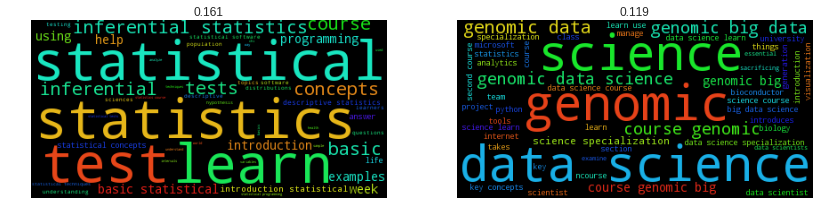

algorithms for predicting structured data 
--------------------------------------------------------------------------------
computer_science video probability_statistics machine_learning mathematics artificial_intelligence in_depth
--------------------------------------------------------------------------------
structured prediction is the problem of predicting multiple outputs with complex internal structure and dependencies among them algorithms and models for predicting structured data have been in use for a long time for example recurrent neural networks and hidden markov models have found interesting applications in temporal pattern recognition problems such as speech recognition with the introduction of support vector machines in the s there has been a lot of interest in the machine learning community in discriminative models of learning in this tutorial we plan to cover recent developments in discriminative learning algorithms for predicting structured data we believe this tutor

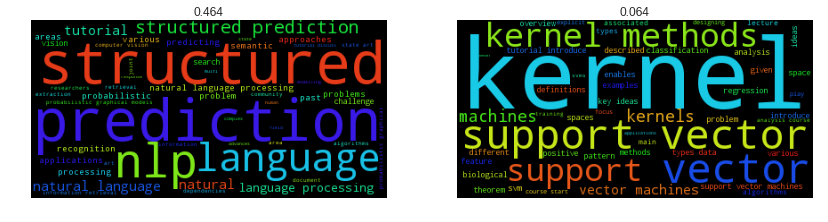

mining massive rfid trajectory and traffic data sets 
--------------------------------------------------------------------------------
computer_science video probability_statistics machine_learning mathematics artificial_intelligence in_depth
--------------------------------------------------------------------------------
with the wide availability of satellite rfid gps sensor wireless and video technologies moving object data has been collected in massive scale and is becoming increasingly rich complex and ubiquitous there is an imminent need for scalable and flexible data analysis over moving object information and thus mining moving object data has become one of major challenges in data mining there have been considerable research efforts on data mining for rfid trajectory and traffic data sets however there has been no systematic tutorial on knowledge discovery from such moving object data sets this tutorial presents a comprehensive organized and state of the art survey on methodol

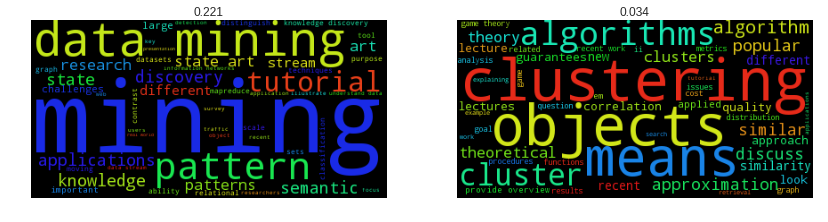

machine learning and signal processing tools for bci 
--------------------------------------------------------------------------------
computer_science video probability_statistics machine_learning mathematics artificial_intelligence in_depth
--------------------------------------------------------------------------------
we will first provide a brief overview of brain computer interface from a machine learning and signal processing perspective in particular showing the wealth the complexity and the difficulties of the data available a truly enormous challenge in real time a multi variate very strongly noise contaminated data stream is to be processed and neuroelectric activities are to be accurately differentiated we will then in detail discuss the components of the data analysis chain employed in modern bci systems spanning all aspects from preprocessing and feature extraction adaptive vs fixed classification and feedback design 
t20 ,t0


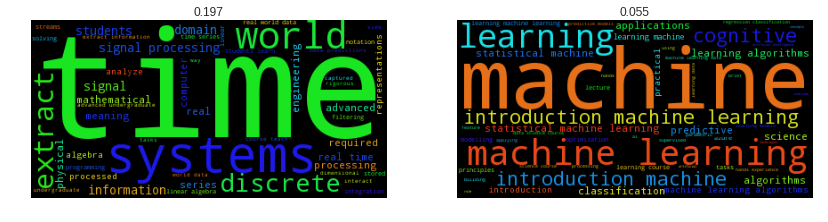

speech recognition and deep learning 
--------------------------------------------------------------------------------
computer_science reinforcement_learning unsupervised_learning video neural_networks probability_statistics machine_learning mathematics artificial_intelligence in_depth
--------------------------------------------------------------------------------

t1 ,t24


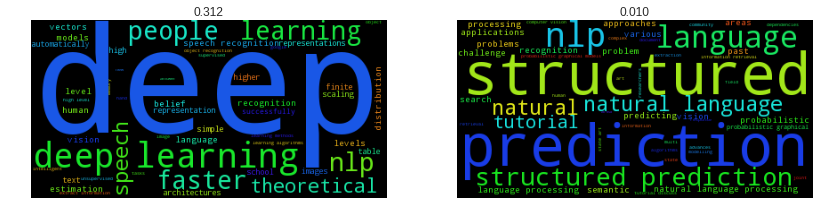

principles of machine learning
--------------------------------------------------------------------------------
computer_science MOOC Python overview R video probability_statistics machine_learning mathematics case_study artificial_intelligence
--------------------------------------------------------------------------------
machine learning uses computers to run predictive models that learn from existing data in order to forecast future behaviors outcomes and trends in this data science course you will be given clear explanations of machine learning theory combined with practical scenarios and hands on experience building validating and deploying machine learning models you will learn how to build and derive insights from these models using r python and azure machine learning 
t0 ,t27


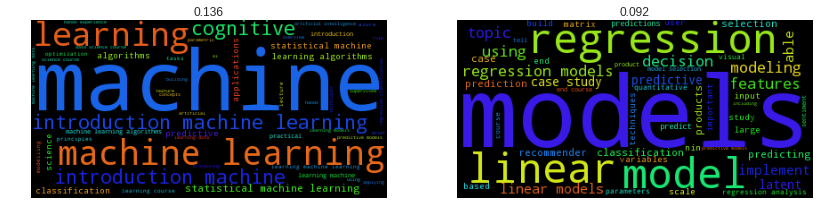

predictive analytics
--------------------------------------------------------------------------------
computer_science MOOC business_analytics video probability_statistics machine_learning mathematics artificial_intelligence in_depth
--------------------------------------------------------------------------------
 decision makers often struggle with questions such as what should be the right price for a product which customer is likely to default in his her loan repayment which products should be recommended to an existing customer finding right answers to these questions can be challenging yet rewarding predictive analytics is emerging as a competitive strategy across many business sectors and can set apart high performing companies it aims to predict the probability of the occurrence of a future event such as customer churn loan defaults and stock market fluctuations leading to effective business management models such as multiple linear regression logistic regression auto regressive

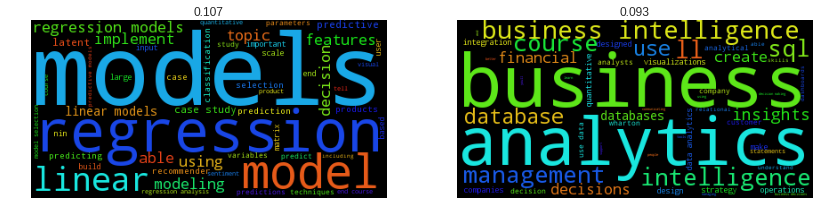

deep learning 
--------------------------------------------------------------------------------
computer_science video probability_statistics machine_learning mathematics artificial_intelligence in_depth
--------------------------------------------------------------------------------
building intelligent systems that are capable of extracting high level representations from high dimensional sensory data lies at the core of solving many ai related tasks including visual object or pattern recognition speech perception and language understanding theoretical and biological arguments strongly suggest that building such systems requires deep architectures that involve many layers of nonlinear processing many existing learning algorithms use shallow architectures including neural networks with only one hidden layer support vector machines kernel logistic regression and many others the internal representations learned by such systems are necessarily simple and are incapable of extracting some 

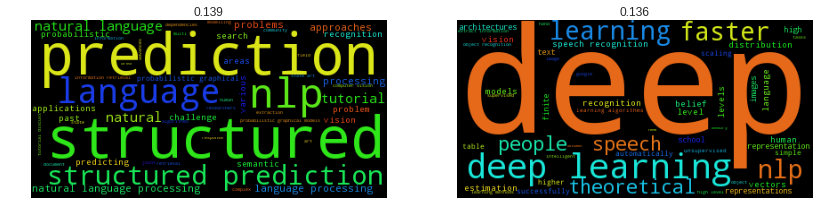

high dimensional data analysis
--------------------------------------------------------------------------------
computer_science clustering biology molecular_biology genetics dimensionality_reduction genomic_proteomic_data unsupervised_learning MOOC video probability_statistics machine_learning mathematics case_study artificial_intelligence in_depth
--------------------------------------------------------------------------------
if you re interested in data analysis and interpretation then this is the data science course for you we start by learning the mathematical definition of distance and use this to motivate the use of the singular value decomposition svd for dimension reduction and multi dimensional scaling and its connection to principle component analysis we will learn about the batch effect the most challenging data analytical problem in genomics today and describe how the techniques can be used to detect and adjust for batch effects specifically we will describe the principal

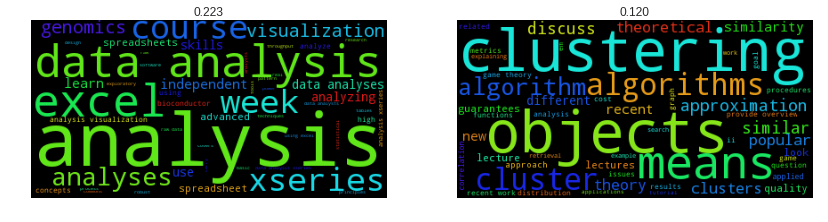

deep reinforcement learning 
--------------------------------------------------------------------------------
computer_science economics social_sciences medicine_healthcare engineering video probability_statistics machine_learning mathematics artificial_intelligence in_depth
--------------------------------------------------------------------------------
in this tutorial i will discuss how reinforcement learning rl can be combined with deep learning dl there are several ways to combine dl and rl together including value based policy based and model based approaches with planning several of these approaches have well known divergence issues and i will present simple methods for addressing these instabilities the talk will include a case study of recent successes in the atari domain where a single agent can learn to play many different games directly from raw pixel input 
t6 ,t1


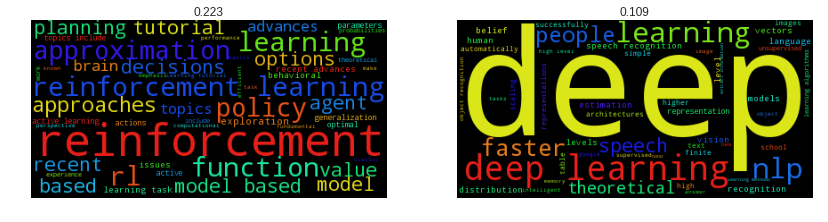

principles of fmri 
--------------------------------------------------------------------------------
fMRI MOOC data_collection neuroimaging video probability_statistics image_data mathematics in_depth
--------------------------------------------------------------------------------
this course covers the design acquisition and analysis of functional magnetic resonance imaging fmri data 
t12 ,t26


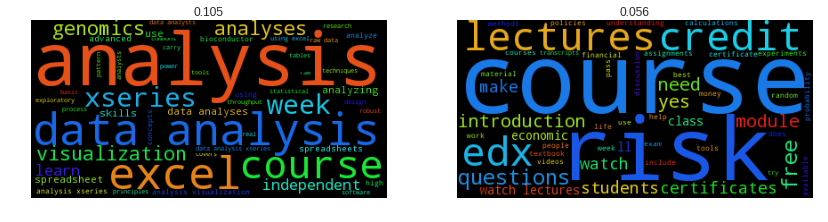

sparse methods for under determined inverse problems 
--------------------------------------------------------------------------------
computer_science video probability_statistics machine_learning mathematics artificial_intelligence in_depth
--------------------------------------------------------------------------------

t18 ,t0


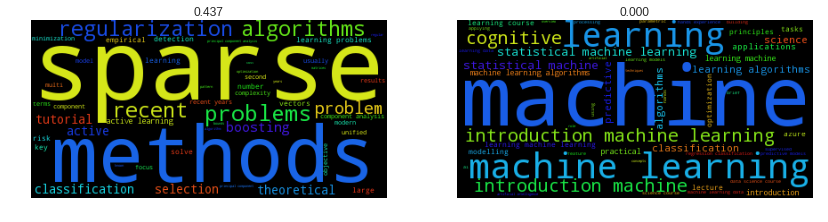

data analysis for your business
--------------------------------------------------------------------------------
course_set business_analytics
--------------------------------------------------------------------------------
advanced data analysis skills are highly sought by data driven organizations who wish to harness data to improve business results the data analysis xseries will help you become a resourceful and independent data analyst who can help organizations reach their goals the xseries covers the main tasks of data analysts data importing cleaning wrangling interpreting and visualizing with special emphasis on real time dashboards you will learn advanced techniques and touch upon data science principles with excel and external plugins this xseries consists of two courses a basic and intermediate course and ends with a project based course which will engage you in a real data analysis project that simulates the complexity and challenges of data analysts in a business environme

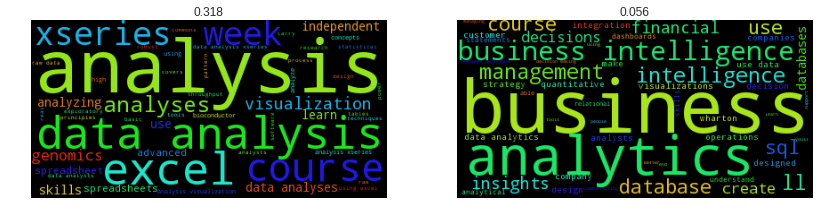

introduction to data analysis using excel
--------------------------------------------------------------------------------
MOOC overview video tabular_data probability_statistics mathematics
--------------------------------------------------------------------------------
the ability to analyze data is a powerful skill that helps you make better decisions microsoft excel is one of the top tools for data analysis and the built in pivot tables are arguably the most popular analytic tool in this course you will learn how to perform data analysis using excel s most popular features you will learn how to create pivot tables from a range with rows and columns in excel you will see the power of excel pivots in action and their ability to summarize data in flexible ways enabling quick exploration of data and producing valuable insights from the accumulated data pivots are used in many different industries by millions of users who share the goal of reporting the performance of companies and orga

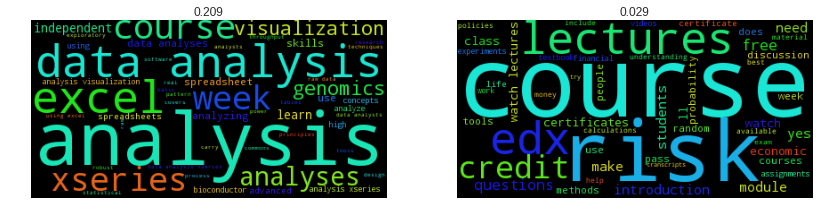

introduction to machine learning 
--------------------------------------------------------------------------------
computer_science reinforcement_learning unsupervised_learning video neural_networks probability_statistics machine_learning mathematics artificial_intelligence in_depth
--------------------------------------------------------------------------------

t0 ,t3


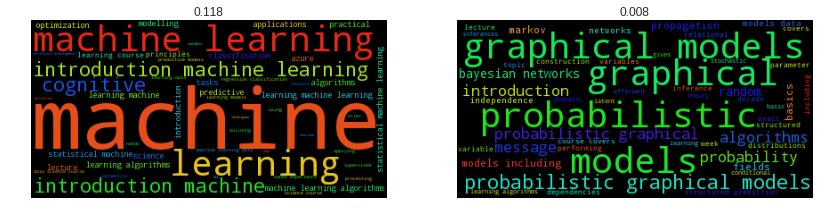

designing running and analyzing experiments
--------------------------------------------------------------------------------
MOOC data_collection business_analytics video probability_statistics mathematics case_study in_depth
--------------------------------------------------------------------------------
you will never know whether you have an effective user experience until you have tested it with users in this course you ll learn how to design experiments how to run experiments and how to analyze data from these experiments in order to evaluate and validate user experiences you will work through real world examples of experiments from the fields of ixd and hci understanding issues in experiment design and analysis you will analyze multiple data sets using recipes given to you in the r statistical programming language no prior programming experience is assumed or required by the end of the course you will be able to knowledgeably design run and analyze your own experiments for puttin

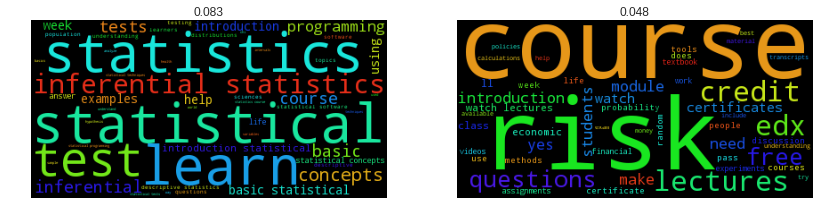

convex optimization in python with cvxpy 
--------------------------------------------------------------------------------
computer_science Python optimization video probability_statistics machine_learning mathematics artificial_intelligence in_depth
--------------------------------------------------------------------------------

t15 ,t23


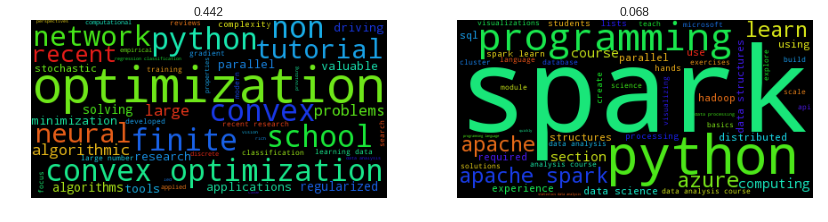

theory methods and applications of active learning 
--------------------------------------------------------------------------------
computer_science video probability_statistics machine_learning mathematics artificial_intelligence in_depth
--------------------------------------------------------------------------------
traditional approaches to machine learning and statistical inference are passive in the sense that all data are collected prior to analysis in a non adaptive fashion one can envision however more active strategies in which information gleaned from previously collected data is used to guide the selection of new data this talk discusses the emerging theory of such active learning methods i will show that feedback between data analysis and data collection can be crucial for effective learning and inference the talk will describe two active learning problems first i will consider binary valued prediction classification problems for which the prediction errors of passive lea

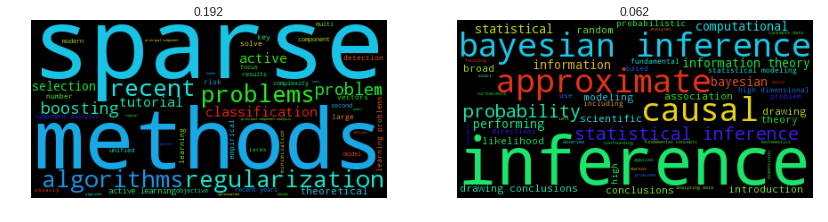

case studies in business analytics with accenture
--------------------------------------------------------------------------------
video MOOC case_study business_analytics in_depth
--------------------------------------------------------------------------------
who is this course for nthis course is restricted to learners enrolled in strategic business analytics specialization as a preparation to the capstone project during the first two moocs we focused on specific techniques for specific applications instead with this third mooc we provide you with different examples to open your mind to different applications from different industries and sectors nthe objective is to give you an helicopter overview on whats happening in this field you will see how the tools presented in the two previous courses of the specialization are used in real life projects nwe want to ignite your reflection process hence you will best make use of the accenture cases by watching first the mooc and then investi

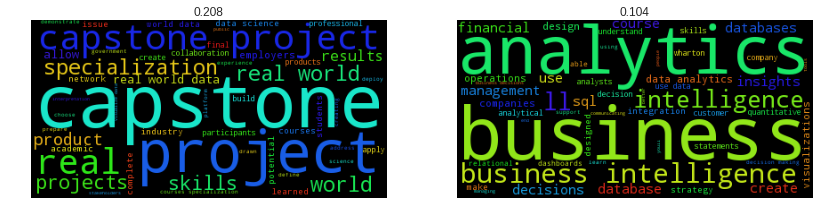

mining complex entities from heterogeneous information networks 
--------------------------------------------------------------------------------
computer_science graph_analytics video in_depth
--------------------------------------------------------------------------------
most research on information mining has focused on classic information extraction ie tasks from structured and unstructured documents like newspaper articles and web pages in the last years however the staggering growth of social media as platform for sharing content has moved the focus towards a different type of extraction target social media pose a number of challenge to information extraction contributions to social media sites like blogs forums twitter etc are conversational in nature and thus tend to be brief and informal containing imprecise subjective and ambiguous information the expanded context who the author is the social and geographical context their social links etc becomes relevant to disambiguate an

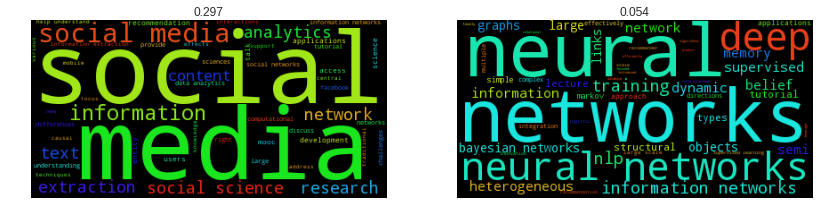

python data structures
--------------------------------------------------------------------------------
computer_science MOOC Python programming video in_depth
--------------------------------------------------------------------------------
this course will introduce the core data structures of the python programming language we will move past the basics of procedural programming and explore how we can use the python built in data structures such as lists dictionaries and tuples to perform increasingly complex data analysis this course will cover chapters of the textbook python for informatics this course is equivalent to the second half of the week programming for everybody python course 
t23 ,t26


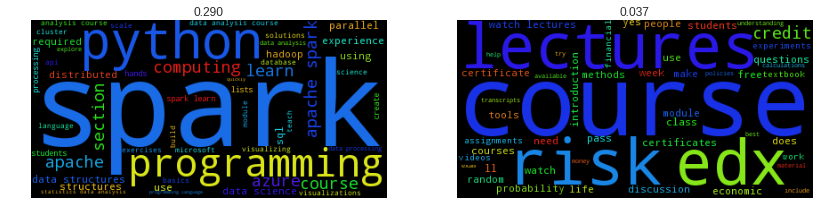

indexing and mining time sequences 
--------------------------------------------------------------------------------
computer_science time_series_data video probability_statistics machine_learning mathematics artificial_intelligence in_depth
--------------------------------------------------------------------------------
how can we find patterns in a sequence of sensor measurements eg a sequence of temperatures or water pollutant measurements how can we compress it what are the major tools for forecasting and outlier detection the objective of this tutorial is to provide a concise and intuitive overview of the most important tools that can help us find patterns in sensor sequences sensor data analysis becomes of increasingly high importance thanks to the decreasing cost of hardware and the increasing on sensor processing abilities we review the state of the art in three related fields a fast similarity search for time sequences b linear forecasting with the traditional ar autoregressiv

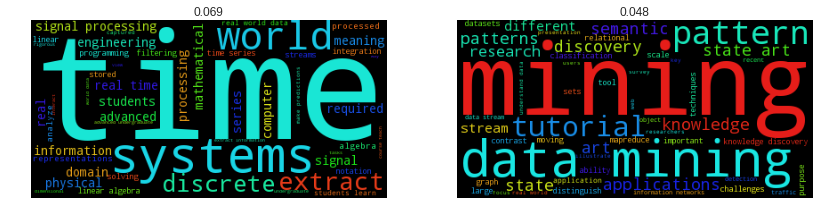

deep learning 
--------------------------------------------------------------------------------
computer_science reinforcement_learning unsupervised_learning video neural_networks probability_statistics machine_learning mathematics artificial_intelligence in_depth
--------------------------------------------------------------------------------

t1 ,t0


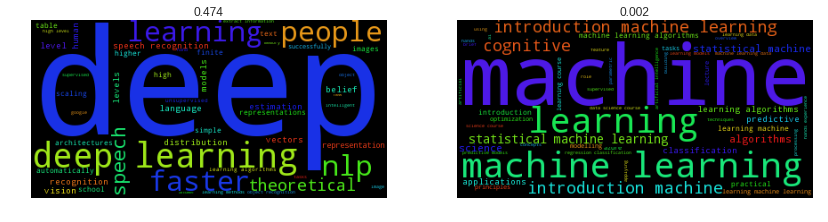

modern convex optimization methods for large scale empirical risk minimization 
--------------------------------------------------------------------------------
computer_science video probability_statistics machine_learning mathematics artificial_intelligence in_depth
--------------------------------------------------------------------------------
this tutorial reviews recent advances in convex optimization for training linear predictors via regularized empirical risk minimization we exclusively focus on practically efficient methods which are also equipped with complexity bounds confirming the suitability of the algorithms for solving huge dimensional problems a very large number of examples or a very large number of features the first part of the tutorial is dedicated to modern primal methods belonging to the stochastic gradient descent variety while the second part focuses on modern dual methods belonging to the randomized coordinate ascent variety while we make this distinction the

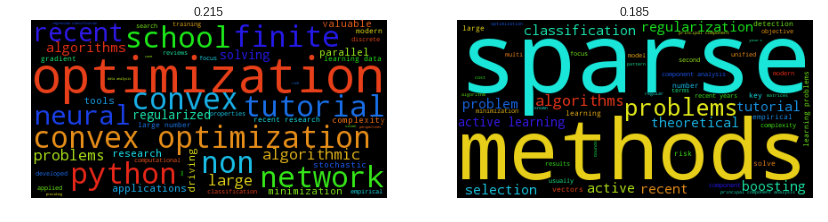

policy analysis using interrupted time series
--------------------------------------------------------------------------------
computer_science MOOC time_series_data project video probability_statistics machine_learning mathematics case_study artificial_intelligence in_depth
--------------------------------------------------------------------------------
interrupted time series analysis and regression discontinuity designs are two of the most rigorous ways to evaluate policies with routinely collected data itsx comprehensively introduces analysts to interrupted time series analysis its and regression discontinuity designs rd from start to finish including definition of an appropriate research question selection and setup of data sources statistical analysis interpretation and presentation and identification of potential pitfalls at the conclusion of the course students will have all the tools necessary to propose conduct and correctly interpret an analysis using its and rd approaches t

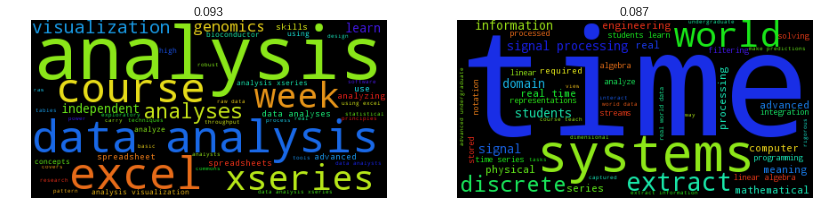

learning bayesian networks 
--------------------------------------------------------------------------------
computer_science unsupervised_learning video probability_statistics machine_learning mathematics artificial_intelligence in_depth
--------------------------------------------------------------------------------
bayesian networks are graphical structures for representing the probabilistic relationships among a large number of variables and doing probabilistic inference with those variables the s saw the emergence of excellent algorithms for learning bayesian networks from passive data i will discuss the constraint based learning method using an intuitive approach that concentrates on causal learning then i will discuss the bayesian approach with some simple examples i will show how using the bayesian approach we can even learning something about causal influences from passive data on two variables finally i will show some applications to finance and marketing 
t7 ,t19


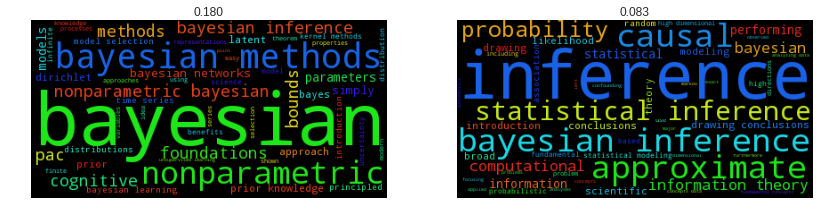

semi supervised learning 
--------------------------------------------------------------------------------
computer_science video probability_statistics machine_learning mathematics artificial_intelligence in_depth
--------------------------------------------------------------------------------
this tutorial covers classification approaches that utilize both labeled and unlabeled data we will review self training gaussian mixture models co training multiview learning graph transduction and manifold regularization transductive svms and a pac bound for semi supervised learning we then discuss some new development including online semi supervised learning multi manifold learning and human semi supervised learning 
t11 ,t6


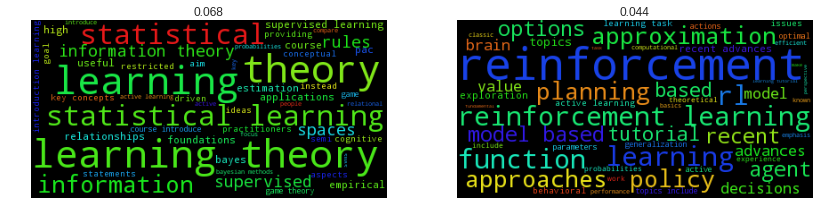

tutorial on machine learning reductions 
--------------------------------------------------------------------------------
computer_science video probability_statistics machine_learning mathematics artificial_intelligence in_depth
--------------------------------------------------------------------------------
there are several different classification problems commonly encountered in real world applications such as importance weighted classification cost sensitive classification reinforcement learning regression and others many of these problems can be related to each other by simple machines reductions that transform problems of one type into problems of another type finding a reduction from your problem to a more common problem allows the reuse of simple learning algorithms to solve relatively complex problems it also induces an organization on learning problems problems that can be easily reduced to each other are nearby and problems which can not be so reduced are not close 
t18 ,t

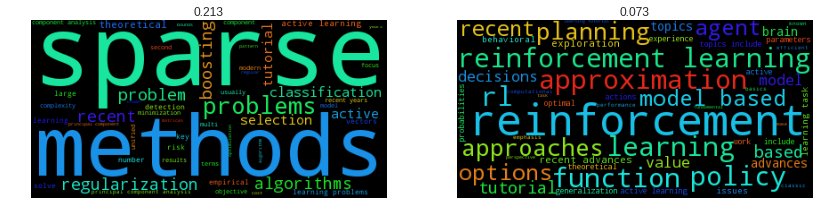

introduction to reinforcement learning and bayesian learning 
--------------------------------------------------------------------------------
computer_science reinforcement_learning unsupervised_learning video probability_statistics machine_learning mathematics artificial_intelligence in_depth
--------------------------------------------------------------------------------
although bayesian methods for reinforcement learning can be traced back to the s howards work in operations research bayesian methods have only been used sporadically in modern reinforcement learning this is in part because non bayesian approaches tend to be much simpler to work with however recent advances have shown that bayesian approaches do not need to be as complex as initially thought and offer several theoretical advantages for instance by keeping track of full distributions instead of point estimates over the unknowns bayesian approaches permit a more comprehensive quantification of the uncertainty regardin

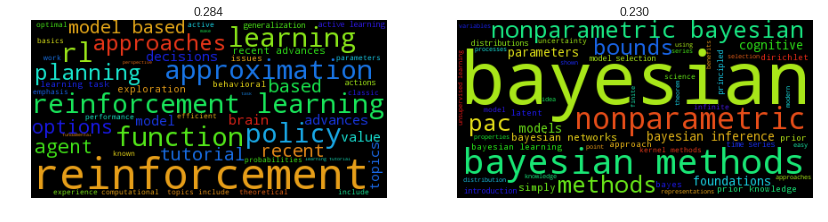

applications of linear algebra part 
--------------------------------------------------------------------------------
computer_science MOOC linear_algebra overview video probability_statistics machine_learning mathematics artificial_intelligence
--------------------------------------------------------------------------------
 our world is in a data deluge with ever increasing sizes of datasets linear algebra is a tool to manage and analyze such data this course is part of a part course with this part extending smoothly from the first note however that part is not a prerequisite for part in this part of the course we ll develop the linear algebra more fully than part this class has a focus on data mining with some applications of computer graphics we ll discuss in further depth than part sports ranking and ways to rate teams from thousands of games we ll apply the methods to march madness we ll also learn methods behind web search utilized by such companies as google we ll also learn to

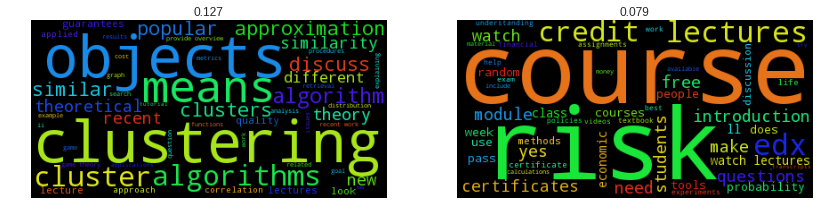

foundations of statistical learning theory empirical infe rence in high dimention spaces 
--------------------------------------------------------------------------------
computer_science video probability_statistics machine_learning mathematics artificial_intelligence in_depth
--------------------------------------------------------------------------------

t11 ,t25


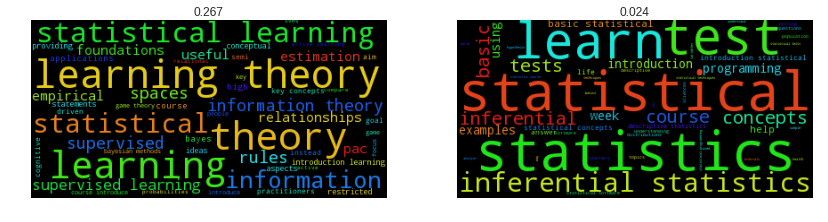

graph analytics for big data
--------------------------------------------------------------------------------
computer_science graph_data MOOC probability_statistics graph_database data_visualization graph_analytics video databases mathematics in_depth
--------------------------------------------------------------------------------
want to understand your data network structure and how it changes under different conditions curious to know how to identify closely interacting clusters within a graph have you heard of the fast growing area of graph analytics and want to learn more this course gives you a broad overview of the field of graph analytics so you can learn new ways to model store retrieve and analyze graph structured data n nafter completing this course you will be able to model a problem into a graph database and perform analytical tasks over the graph in a scalable manner better yet you will be able to apply these techniques to understand the significance of your data sets fo

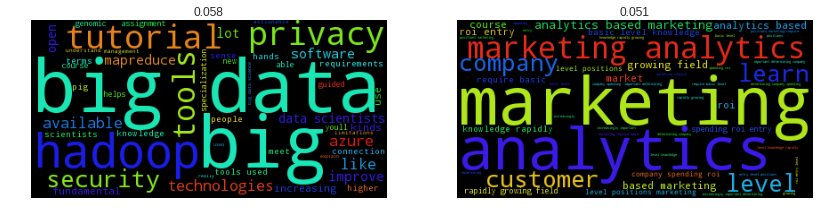

capstone create value from open data
--------------------------------------------------------------------------------
MOOC business_analytics project_focused project video probability_statistics mathematics
--------------------------------------------------------------------------------
the capstone project is an individual assignment nparticipants decide the theme they want to explore and define the issue they want to solve their playing field should provide data from various sectors such as farming and nutrition culture economy and employment education research international europe housing sustainable development energies health social society territories transport participants are encouraged to mix the different fields and leverage the existing information with other properly sourced open data sets n nduring step one project objectives qualification and identification of the data sets participants should explore the data set and define fix their objectives they will have to define t

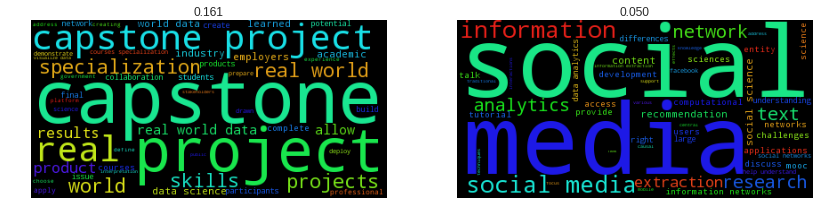

digital analytics for marketing professionals marketing analytics in practice
--------------------------------------------------------------------------------
MOOC data_collection probability_statistics business_analytics video data_visualization mathematics case_study in_depth
--------------------------------------------------------------------------------
this course builds on the theory and foundations of marketing analytics and focuses on practical application by demystifying the use of data in marketing and helping you realize the power of visualizing data with artful use of numbers found in the digital space 
t10 ,t11


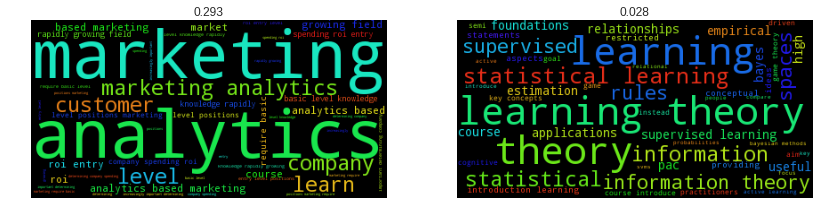

bounding excess risk in machine learning 
--------------------------------------------------------------------------------
computer_science video probability_statistics machine_learning mathematics artificial_intelligence in_depth
--------------------------------------------------------------------------------
we will discuss a general approach to the problem of bounding the excess risk of learning algorithms based on empirical risk minimization possibly penalized this approach has been developed in the recent years by several authors among others massart bartlett bousquet and mendelson koltchinskii it is based on powerful concentration inequalities due to talagrand as well as on a variety of tools of empirical processes theory comparison inequalities entropy and generic chaining bounds on gaussian empirical and rademacher processes etc it provides a way to obtain sharp excess risk bounds in a number of problems such as regression density estimation and classification and for many diff

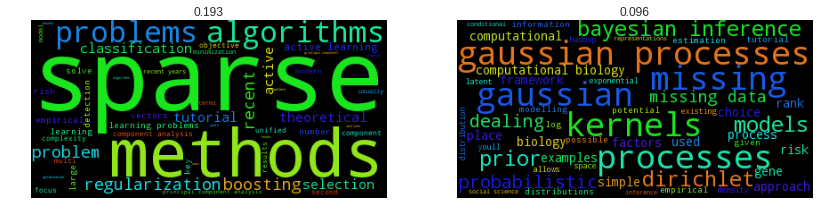

the data scientist s toolbox
--------------------------------------------------------------------------------
computer_science MOOC overview programming project R video reproducibility
--------------------------------------------------------------------------------
in this course you will get an introduction to the main tools and ideas in the data scientists toolbox the course gives an overview of the data questions and tools that data analysts and data scientists work with there are two components to this course the first is a conceptual introduction to the ideas behind turning data into actionable knowledge the second is a practical introduction to the tools that will be used in the program like version control markdown git github r and rstudio 
t26 ,t5


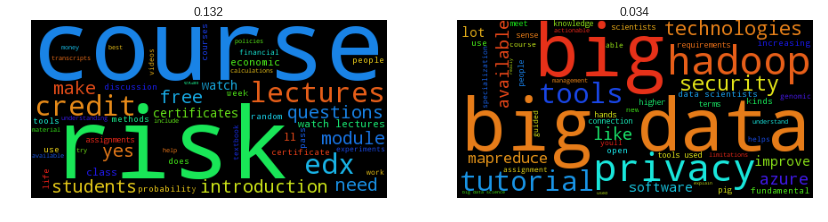

model based reinforcement learning 
--------------------------------------------------------------------------------
computer_science reinforcement_learning video probability_statistics machine_learning mathematics artificial_intelligence in_depth
--------------------------------------------------------------------------------
in model based reinforcement learning an agent uses its experience to construct a representation of the control dynamics of its environment it can then predict the outcome of its actions and make decisions that maximize its learning and task performance this tutorial will survey work in this area with an emphasis on recent results topics will include efficient learning in the pac mdp formalism bayesian reinforcement learning models and linear function approximation recent advances in planning 
t6 ,t27


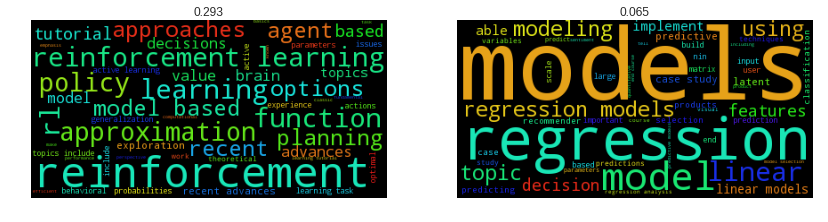

pragmatic randomized controlled trials in health care
--------------------------------------------------------------------------------
MOOC data_collection video medicine_healthcare case_study in_depth
--------------------------------------------------------------------------------
for the first hundreds of years of modern medicine progress was a process of trial and error and to be honest it was often fatal error such as bloodletting which killed the first us president george washington where diseases were clearly understood and where treatments obviously worked on most patients such as penicillin for pneumonia there was no need to delve deeper into questions of effectiveness but for most conditions the treatment benefits were modest and there was a need for improved ways of telling whether a new intervention was better than the previous standard treatment and so scientists introduced a testing procedure for new treatments the randomized controlled trial as the cost of developing new 

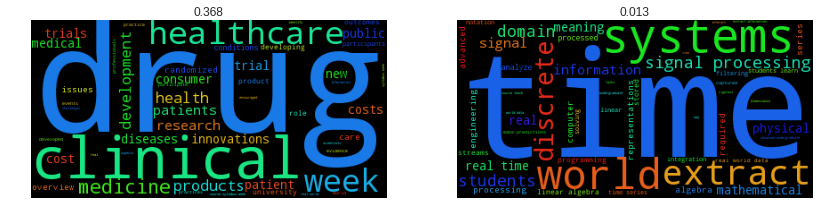

intro to computer science
--------------------------------------------------------------------------------
computer_science graph_data MOOC data_collection Python overview data_integration project graph_analytics video
--------------------------------------------------------------------------------
in this introduction to computer programming course you ll learn and practice key computer science concepts by building your own versions of popular web applications you ll learn python a powerful easy to learn and widely used programming language and you ll explore computer science basics as you build your own search engine and social network 
t17 ,t23


In [ ]:
df_vec = clf.transform(df[['title', 'subtitle', 'description', 'syllabus']])
for (idx, row), vec in zip(df.iterrows(), df_vec):
    print('=' * 80)
    print(row['title'])
    print('-' * 80)
    print(row['tag'])
    print('-' * 80)
    print(row['description'])
    fig, ax = plt.subplots(1, 2, figsize=(14, 8))
    res_topics = list()
    for ax_idx, (val_idx, val) in enumerate(sorted(enumerate(vec), key=itemgetter(1), reverse=True)[:2]):
        #print(val_idx, val)
        wordcloud(clf.topic_dict[val_idx], ax=ax[ax_idx])
        ax[ax_idx].set_title("%.3f" % val)
        ax[ax_idx].axis("off")
        res_topics.append(val_idx)
    print(' ,'.join('t'+ str(i) for i in res_topics))
    plt.show()